In [3]:
#KENAR DESENİ KODLAMADDA KOD SIRASI VE KODLARIN IoU su aşağıdaki gibidir;

In [1]:
# (4_3 MADDE) GÖRÜNTÜ + LABEL + BOUNDARY + HOG + CROSS KOLERASYON + IoU : Final Image IoU: 0.6477
# (4_4 MADDE) LABEL KENARI K ÇAPLI + BOUNDARY + HOG + CROSS KOLERASYON + IoU : Final Image IoU: 0.6185
# (4_1 MADDE) BOUNDARY + GÖRÜNTÜ KENAR ÇİZGİLERİ + HOG + SOBEL NOKTA +  CROSS KOLERASYON + IoU: Final Image IoU: 0.7020
# (4_2 MADDE) BOUNDARY + GÖRÜNTÜ KENAR ÇİZGİLERİ + TEK HOG + SOBEL NOKTA +  CROSS KOLERASYON +  IoU : Final Image IoU: 0.7137 
# (4_5 MADDE SOBELLE DENENMESİ)  LABEL KENARI K ÇAPLI + BOUNDARY + HOG + SOBEL HOG + CROSS KOLERASYON + IoU Final Image IoU: 0.6302

#EN İYİ IoU: 0.7137 İLE (4_2 MADDE) DİR.

In [52]:
#BU AŞAMADA İSTENEN 4 MADDE VE EKSTRA 1 MADDE OLMAK ÜZERE TOPLAM 5 AŞAMA BAŞARILI BİR ŞEKİLDE ÇALIŞTIRILMIŞ VE
#IoU LARI HESAPLANMIŞTIR
# EN İYİ IoU ; 0.7137 İLE (4_2 MADDE) BOUNDARY + GÖRÜNTÜ KENAR ÇİZGİLERİ +  TEK HOG + SOBEL NOKTA +  CROSS KOLERASYON +  IoU OLMUŞTUR

In [53]:
# (4_3 MADDE) GÖRÜNTÜ + LABEL + BOUNDARY + HOG + CROSS KOLERASYON + IoU 

#HER GÖRÜNTÜDEN BOUNDARY İLE ALDIĞIMIZ KENAR NOKTALARINDAN ALDIĞIMIZ PACHLERİ HOG İLE KODLADIK
#KODLANAN BU HOG KODLARI İLE TEST GÖRSELİNİN HOG KODLARINI CROSS KOLERASYON YARDIMI İLE KARŞILAŞTIRDIK EŞLEŞEN NOKTALARI İŞARETLEDİK
#SON OLARAK MORFOLOJİK OPERASYONLARDAN GEÇİRİP IoU HESAPLADIK

In [50]:
#MODELLEME AŞAMASI

In [51]:
#KÜTÜPHANELERİ İMPORT EDİYORUZ

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
import importlib
import utils
importlib.reload(utils)
from utils import *

In [2]:
#EĞİTİM GÖRSELİ VE LABELLERİ ÖN İŞLEMDEN GEÇİRİLEREK GÖRSELLEŞTİRİLİYOR (I1 Norm +Ortalama (Mean) +Parlaklık +Keskinleştirme)

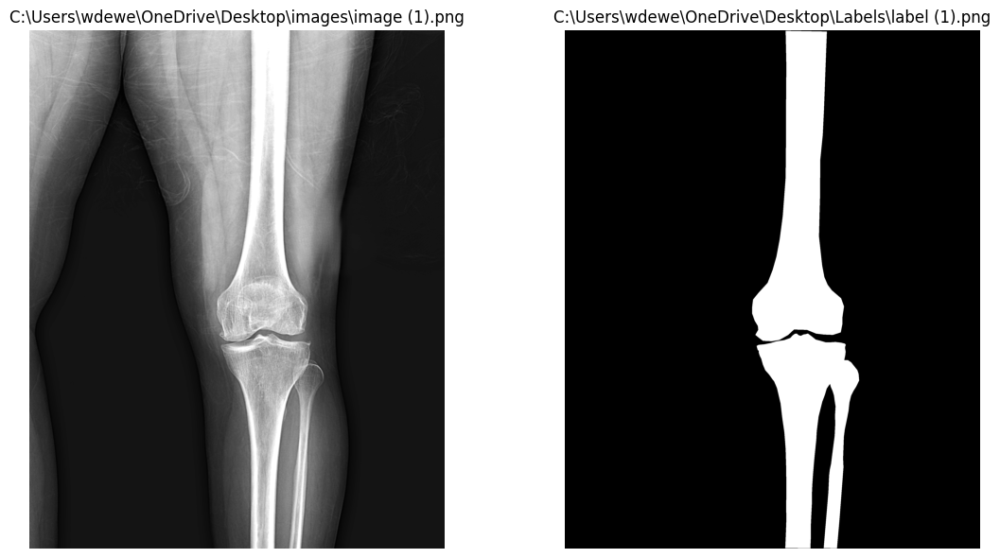

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
img, label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (1).png",
    draw=True
)


In [58]:
#YAZDIRMA KODLARI

In [3]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()  

In [60]:
#LABEL VE BOUNDARY İLE KENAR NOKTALARINI BULDUK

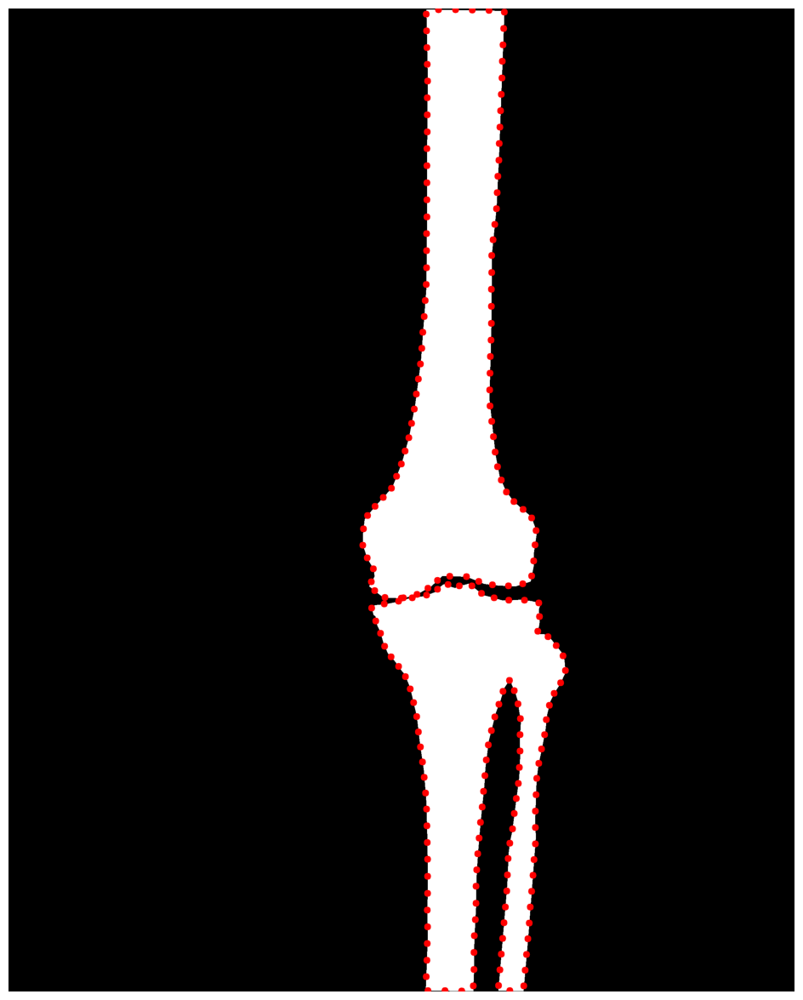

In [4]:
def GetLabelEdgePoints(img, sparsity_factor=1, circle_radius = 10, draw=False):
    contours = measure.find_contours(img, level=0.5)
    # Tüm sınır piksellerini birleştir
    boundary_points = np.vstack(contours)
    
    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        boundary_points = boundary_points[::sparsity_factor]
        
    if draw:
        Drawing(img, EdgePoints=boundary_points, circle_radius=circle_radius)

    return boundary_points.astype(int)

# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=50, circle_radius=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)

In [62]:
#BOUNDARY İLE BULDUĞUMUZ NOKTALARDAN PACHLER ALDIK

C:\Users\wdewe\AppData\Local\Temp\ipykernel_24472\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


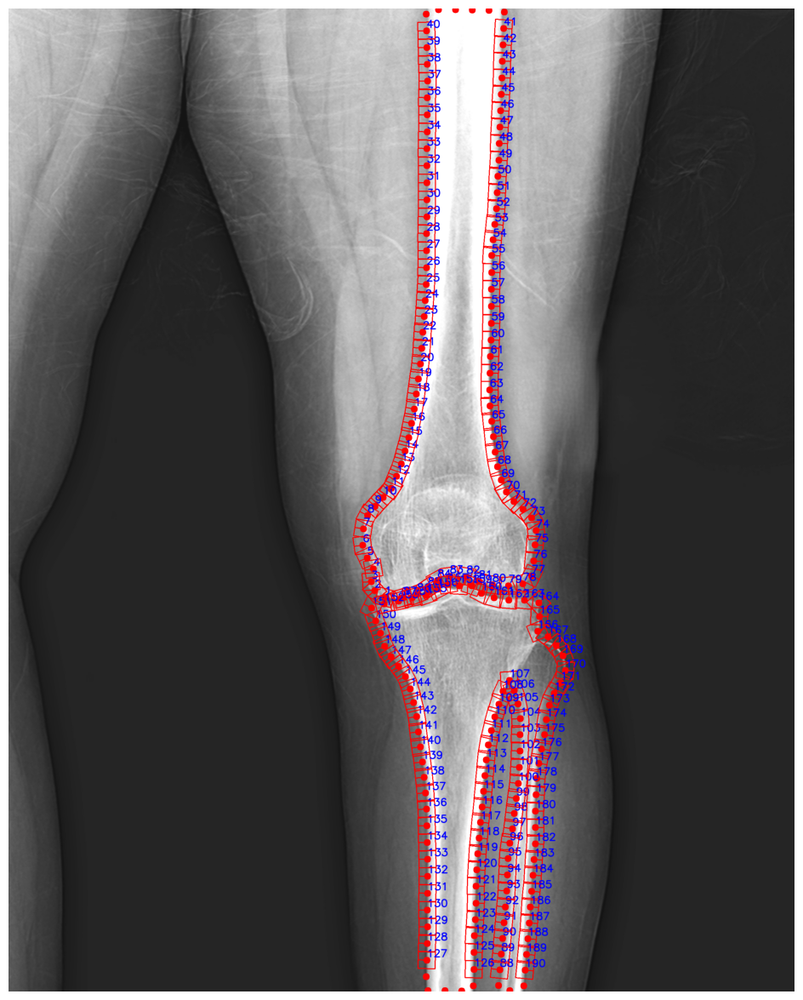

In [5]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo

# img_EdgePoints --> img_EdgePatchs 
img_EdgePatchs, img_EdgePatchsInfo = GetEdgePatchs(img, img_EdgePoints, PatchSize=50, draw=True)  # M = 2*PatchSize + 1,  MxM = 101x101

In [ ]:
#PACH LERİ GÖRSELLEŞTİRDİK

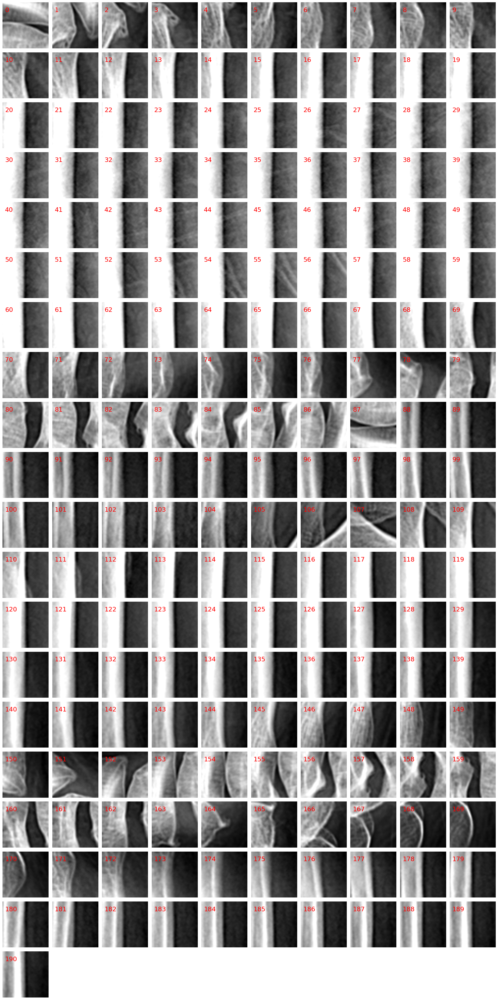

In [6]:
def DisplayPatches(EdgePatchs, max_cols=10):
    # Toplam patch sayısı
    num_patches = len(EdgePatchs)
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()


# img_EdgePatchs gorsellerini tek figurede gor (donmusmuyu kontrol et)
DisplayPatches(img_EdgePatchs)

In [ ]:
#TÜM PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK

In [7]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")



# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png", cv2.IMREAD_GRAYSCALE)



# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\hog_features_with_coords.npz"
save_hog_features_with_coords(img_EdgePatchs, img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\hog_features_with_coords.npz
Toplam 191 patch HOG ile kodlandı.


In [ ]:
#TEST AŞAMASI

In [ ]:
#TEST GÖRSELİNİ ÖN İŞLEMDEN GEÇİRİP GÖRÜNTÜLEDİK

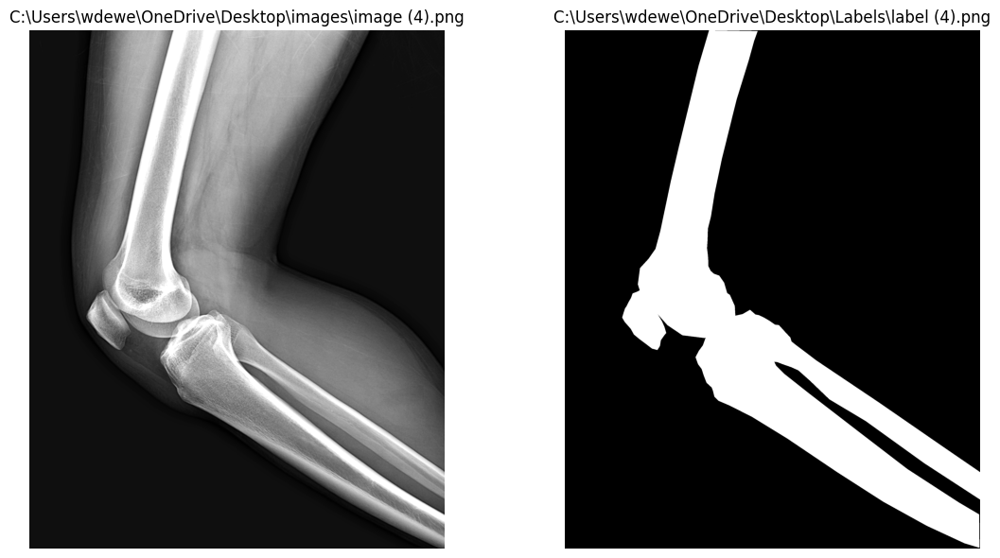

In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
test_img, test_label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (4).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (4).png",
    draw=True
)


In [ ]:
#CANY İLE KENAR NOKTALARI ALDIK

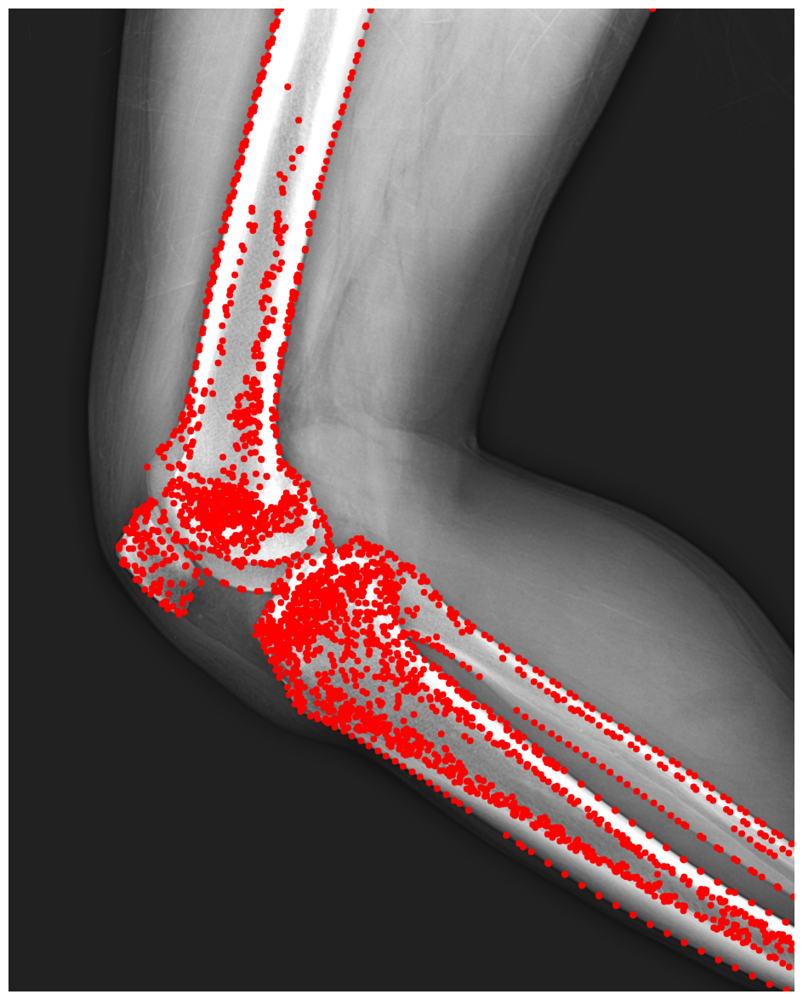

In [9]:
def GetCannyEdgePoints(img, sparsity_factor=1, draw=False):
    blurimg = cv2.GaussianBlur(img, (5, 5), 0)
    edges = cv2.Canny(blurimg, 25, 75)
    CannyEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in CannyEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    return EdgePoints

test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=50, draw=True)   # EdgePoints --> [p,2] --> (y,x)

In [ ]:
#BU NOKTALARDAN PACHLER ALDIK

C:\Users\wdewe\AppData\Local\Temp\ipykernel_24472\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


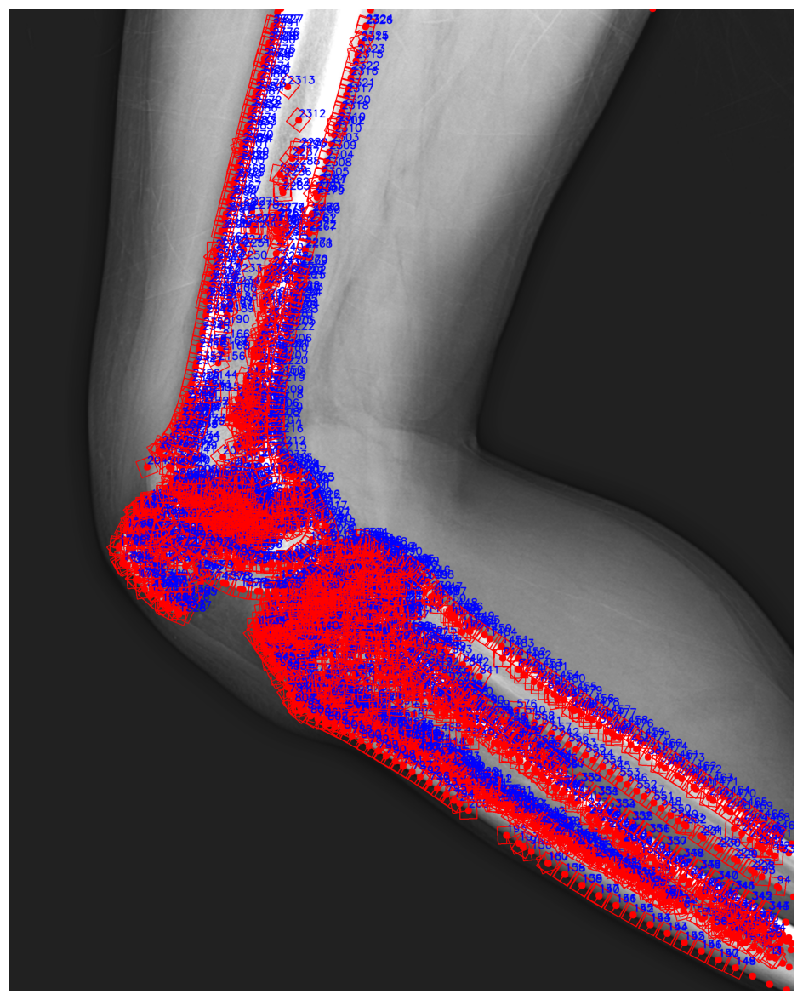

In [10]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo


test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=50, draw=True)

In [ ]:
#ALDIĞIMIZ PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK (Toplam 2392 patch HOG ile kodlandı.)

In [11]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")

# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (4).png", cv2.IMREAD_GRAYSCALE)

# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\test_image4_hog_features_with_coords.npz"
save_hog_features_with_coords(test_img_EdgePatchs, test_img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(test_img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\test_image4_hog_features_with_coords.npz
Toplam 2392 patch HOG ile kodlandı.


In [41]:
#DOSYADA Kİ KAYITLI KLASÖRÜN ANAHTARINI SORGULAYAN KOD

In [12]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\test_image4_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['features', 'coords']


In [ ]:
#HOG KODLARINI CROSS KOLERASYONLA KARŞILAŞTIRDIK.

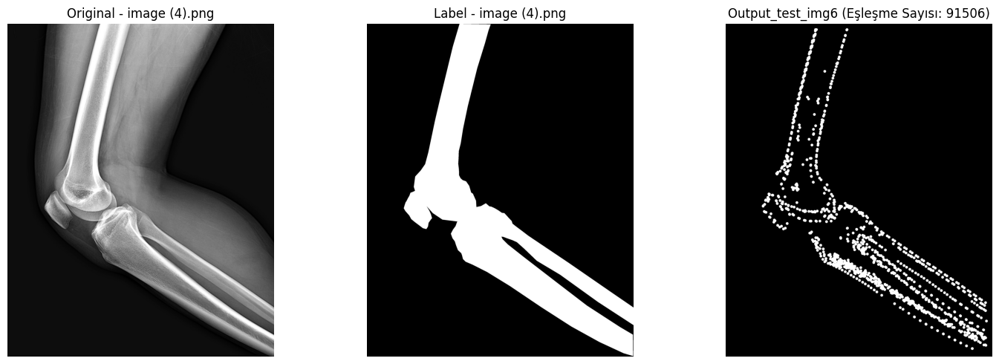

In [13]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (4).png"
]

label_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (4).png"
]

hog_files = [
    r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_3\test_image4_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
output_images = []  # Sonuç görsellerini tutmak için bir liste oluştur
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    # Test HOG vektörlerini ve koordinatlarını yükleme
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['features']
    test_coords = hog_data['coords']
    
    # Test görüntüsünü yükleme
    test_image = cv2.imread(test_image_path)
    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma
    
    # Etiket görüntüsünü yükleme
    label_image = cv2.imread(label_image_path)

    # Çapraz korelasyonu hızlı hesaplama
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, stored_idx in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        matching_coords_count += 1
    
    # Görüntü adını dosya yolundan çıkarma
    image_name = test_image_path.split("\\")[-1]
    
    # Sonuç görselini output_images listesine ekleme
    output_images.append(output_img)
    
    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output_test_img{idx + 6} (Eşleşme Sayısı: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Sonuç görsellerini bir değişkende tutma
final_output_image = output_images[-1]  # Son görseli tutan değişken


In [ ]:
#FİNAL GÖRÜNTÜSÜNE MORFOLOJİK MÜDAHALELER

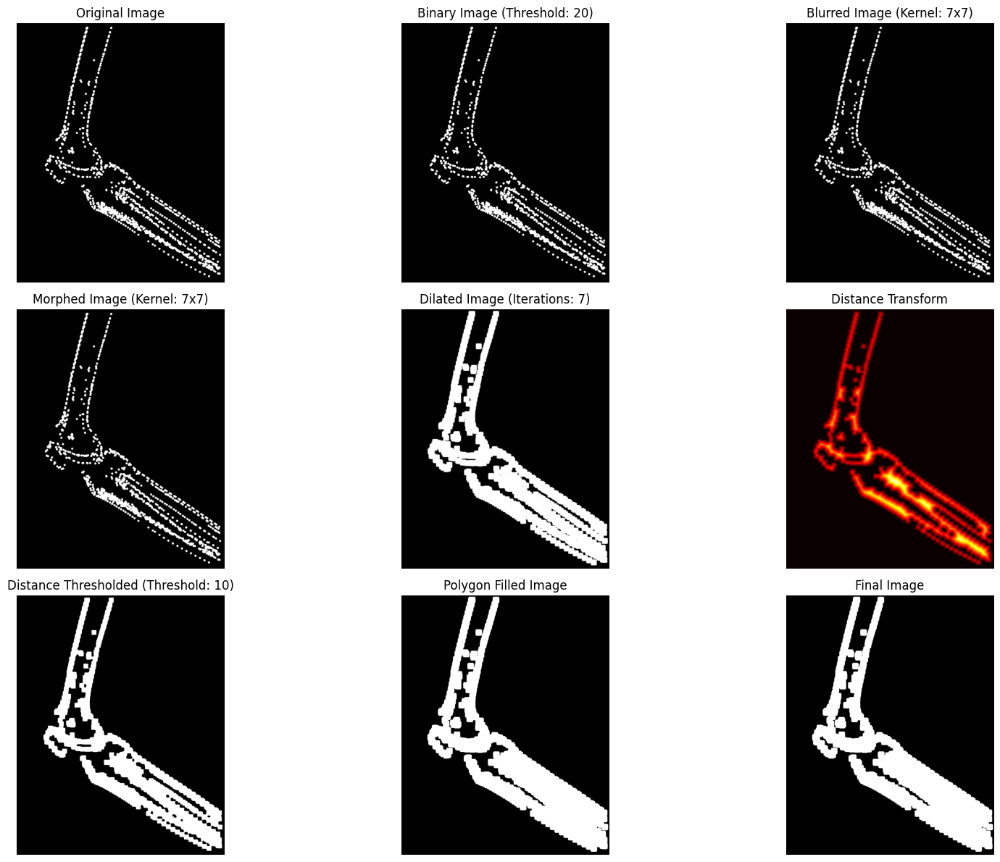

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme ve gri tonlamaya dönüştürme
if isinstance(final_output_image, np.ndarray):
    if len(final_output_image.shape) == 3:  # Eğer görüntü renkli ise gri tonlamaya dönüştür
        image = cv2.cvtColor(final_output_image, cv2.COLOR_BGR2GRAY)
    else:
        image = final_output_image  # Zaten gri tonlamalı
else:
    image = cv2.imread(final_output_image, cv2.IMREAD_GRAYSCALE)

if image is None:
    raise ValueError("Görüntü yüklenemedi. Lütfen doğru yolu kontrol edin veya geçerli bir NumPy dizisi kullanın.")

# --- Ayarlanabilir Eşik Değerleri ---
threshold_value_initial = 20  # İlk eşik değeri (örneğin kenar tespiti için)
blur_kernel_size = 7          # Bulanıklaştırma için kernel boyutu
morph_kernel_size = 7         # Morfolojik işlemler için kernel boyutu
dilate_iterations = 7         # Dilatasyon iterasyon sayısı
distance_threshold_value = 10 # Distance transform için eşik değeri

# --- Kenarları Tespit Etme ---
_, binary_image = cv2.threshold(image, threshold_value_initial, 255, cv2.THRESH_BINARY)

# --- Bulanıklaştırma ---
blurred_image = cv2.GaussianBlur(binary_image, (blur_kernel_size, blur_kernel_size), 0)

# --- Morfolojik İşlemler: Closing ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (morph_kernel_size, morph_kernel_size))
morphed_image = cv2.morphologyEx(blurred_image, cv2.MORPH_CLOSE, kernel)

# --- Dilatasyon ile Noktaları Birleştirme ---
dilated_image = cv2.dilate(morphed_image, kernel, iterations=dilate_iterations)

# --- Distance Transform ---
distance_transform = cv2.distanceTransform(dilated_image, cv2.DIST_L2, 5)
_, distance_thresholded = cv2.threshold(distance_transform, distance_threshold_value, 255, cv2.THRESH_BINARY)
distance_thresholded = distance_thresholded.astype(np.uint8)

# --- Bağlantılı Bileşen Analizi ---
num_labels, labels_im = cv2.connectedComponents(distance_thresholded)

# --- Konturları Bulma ve Poligon Oluşturma ---
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
polygon_image = np.zeros_like(dilated_image)

for contour in contours:
    # Konturların içini beyaz yap (poligon şekli)
    cv2.fillPoly(polygon_image, [contour], 255)

# Poligon içindeki alanları beyaz yap
final_image = cv2.bitwise_or(dilated_image, polygon_image)

# --- Sonuçları Görselleştirme ---
plt.figure(figsize=(18, 12))

# Orijinal Görüntü
plt.subplot(3, 3, 1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

# İlk Eşiklenmiş Görüntü
plt.subplot(3, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title(f"Binary Image (Threshold: {threshold_value_initial})")
plt.axis('off')

# Bulanıklaştırılmış Görüntü
plt.subplot(3, 3, 3)
plt.imshow(blurred_image, cmap='gray')
plt.title(f"Blurred Image (Kernel: {blur_kernel_size}x{blur_kernel_size})")
plt.axis('off')

# Morfolojik İşlemler Sonrası Görüntü
plt.subplot(3, 3, 4)
plt.imshow(morphed_image, cmap='gray')
plt.title(f"Morphed Image (Kernel: {morph_kernel_size}x{morph_kernel_size})")
plt.axis('off')

# Dilatasyon Sonrası Görüntü
plt.subplot(3, 3, 5)
plt.imshow(dilated_image, cmap='gray')
plt.title(f"Dilated Image (Iterations: {dilate_iterations})")
plt.axis('off')

# Distance Transform Sonrası Görüntü
plt.subplot(3, 3, 6)
plt.imshow(distance_transform, cmap='hot')
plt.title("Distance Transform")
plt.axis('off')

# Distance Threshold Sonrası Görüntü
plt.subplot(3, 3, 7)
plt.imshow(distance_thresholded, cmap='gray')
plt.title(f"Distance Thresholded (Threshold: {distance_threshold_value})")
plt.axis('off')

# Poligon İçinde Beyaz Alanlar
plt.subplot(3, 3, 8)
plt.imshow(polygon_image, cmap='gray')
plt.title("Polygon Filled Image")
plt.axis('off')

# Final Görüntü
plt.subplot(3, 3, 9)
plt.imshow(final_image, cmap='gray')
plt.title("Final Image")
plt.axis('off')

plt.tight_layout()
plt.show()



In [ ]:
#IoU HESAPLAMA

Final Image IoU: 0.5862


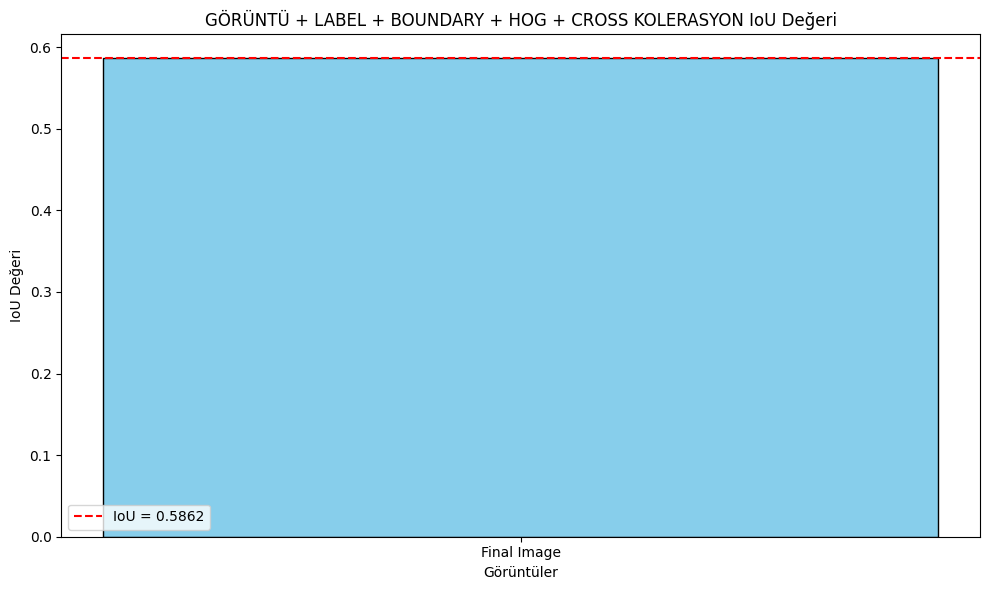

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(predicted_image, 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# final_image'i kontrol etme
if final_image is None:
    print("Final görüntüsü yüklenemedi!")
else:
    # Eğer final_image zaten gri tonlamalıysa, doğrudan eşikleme yapabilirsiniz
    _, final_binary = cv2.threshold(final_image, 127, 255, cv2.THRESH_BINARY)

# Etiket görüntüsünü yükleme ve kontrol etme
label_image = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (4).png", cv2.IMREAD_GRAYSCALE)  # Etiket görüntüsünün yolu buraya girilmeli
if label_image is None:
    print("Etiket görüntüsü yüklenemedi!")
else:
    # Etiket görüntüsünü ikili hale getirme
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)


# IoU hesaplama
if final_image is not None and label_image is not None:
    iou = calculate_iou(final_binary, label_binary)
    print(f"Final Image IoU: {iou:.4f}")

    # IoU Grafik Çıktısı
    plt.figure(figsize=(10, 6))
    plt.bar(["Final Image"], [iou], color='skyblue', edgecolor='black')
    plt.axhline(iou, color='red', linestyle='--', label=f"IoU = {iou:.4f}")
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('GÖRÜNTÜ + LABEL + BOUNDARY + HOG + CROSS KOLERASYON IoU Değeri')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [1]:
#############################################################################################################################################

In [1]:
# (4_4 MADDE) LABEL KENARI K ÇAPLI + BOUNDARY + HOG + CROSS KOLERASYON + IoU Final Image IoU: 0.6185

#HER GÖRÜNTÜDEN BOUNDARY İLE ALDIĞIMIZ KENAR NOKTALARINDAN ALDIĞIMIZ PACHLERİ HOG İLE KODLADIK
#KODLANAN BU HOG KODLARI İLE TEST GÖRSELİNİN HOG KODLARINI CROSS KOLERASYON YARDIMI İLE KARŞILAŞTIRDIK EŞLEŞEN NOKTALARI İŞARETLEDİK
#SON OLARAK MORFOLOJİK OPERASYONLARDAN GEÇİRİP IoU HESAPLADIK

In [3]:
#MODELLEME AŞAMASI

In [4]:
#KÜTÜPHANELERİ İMPORT EDİYORUZ

In [5]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
import importlib
import utils
importlib.reload(utils)
from utils import *

In [6]:
#EĞİTİM GÖRSELİ VE LABELLERİ ÖN İŞLEMDEN GEÇİRİLEREK GÖRSELLEŞTİRİLİYOR

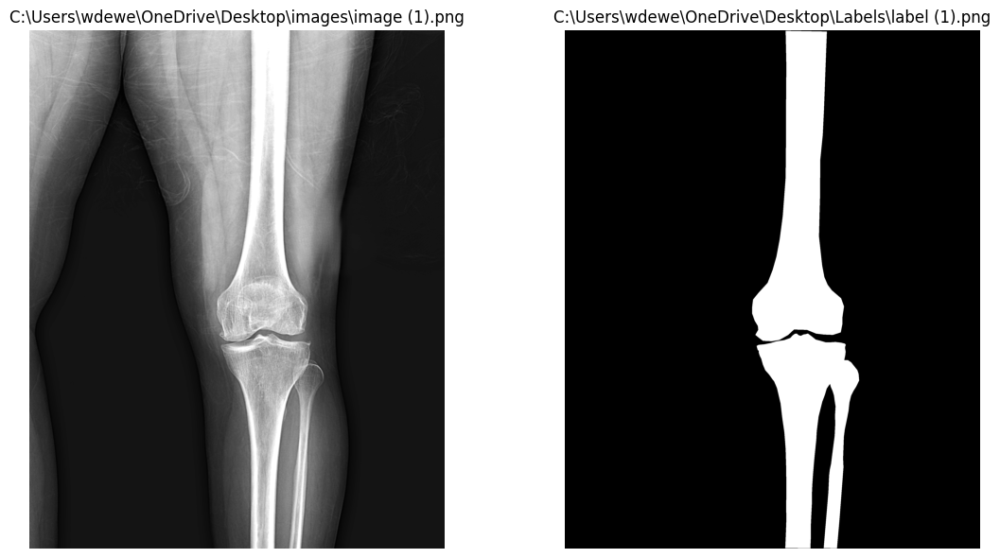

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
img, label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (1).png",
    draw=True
)


In [8]:
#YAZDIRMA KODLARI

In [7]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()  

In [10]:
#k ÇAPLI DAİRESEL ALAN KADAR KENAR NOKTALARINı ALDIK

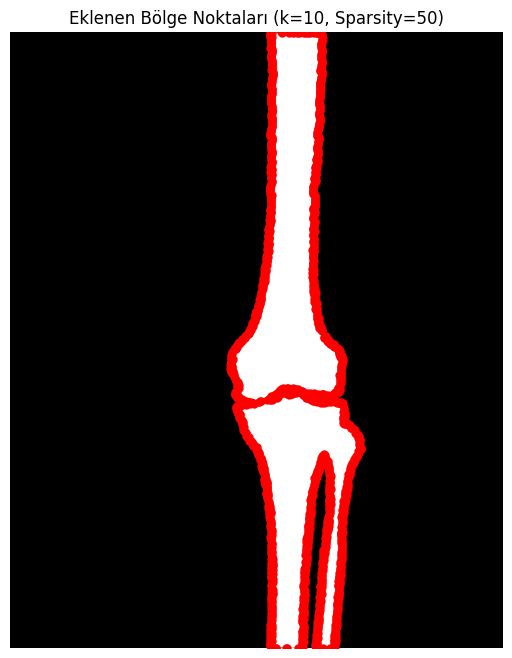

Bulunan Eklenen Noktaların Sayısı: 1774


In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def GetExpandedRegionPoints(label, k=10, sparsity_factor=1, draw=False):
    """
    Genişletilmiş label'den orijinal label'i çıkararak eklenen bölgelerin noktalarını döndürür.

    Args:
        label (numpy.ndarray): İkili (binary) label görüntüsü.
        k (int): Yapısal elementin yarıçapı.
        sparsity_factor (int): Seyrekleştirme faktörü.
        draw (bool): Noktaları çizmek için True.

    Returns:
        numpy.ndarray: Seyrekleştirilmiş nokta koordinatları (y, x).
    """
    # Dairesel yapısal element oluştur
    struct_elem = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2 * k + 1, 2 * k + 1))

    # Label genişletme (dilate)
    dilated_label = cv2.dilate(label, struct_elem)

    # Genişletilmiş label'den orijinal label'i çıkar
    expanded_region = cv2.subtract(dilated_label, label)

    # Eklenen bölgenin tüm piksellerini al
    points = np.column_stack(np.where(expanded_region > 0))  # Tüm beyaz piksellerin koordinatları

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        points = points[::sparsity_factor]

    # Çizim yapılacaksa
    if draw:
        plt.figure(figsize=(8, 8))
        plt.imshow(label, cmap='gray')
        for point in points:
            y, x = point
            plt.plot(x, y, 'ro', markersize=5)
        plt.title(f"Eklenen Bölge Noktaları (k={k}, Sparsity={sparsity_factor})")
        plt.axis('off')
        plt.show()

    return points

# Kullanım
# img ve label, GetImageLabel fonksiyonu ile alındıktan sonra aşağıdaki kod çalıştırılabilir
expanded_points = GetExpandedRegionPoints(label, k=10, sparsity_factor=50, draw=True)

# Bulunan noktaların sayısını yazdır
print(f"Bulunan Eklenen Noktaların Sayısı: {len(expanded_points)}")


In [12]:
#k ÇAPLI DAİRESEL ALAN KADAR KENAR NOKTALARINDAN PACHLER ALDIK

C:\Users\wdewe\AppData\Local\Temp\ipykernel_5320\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


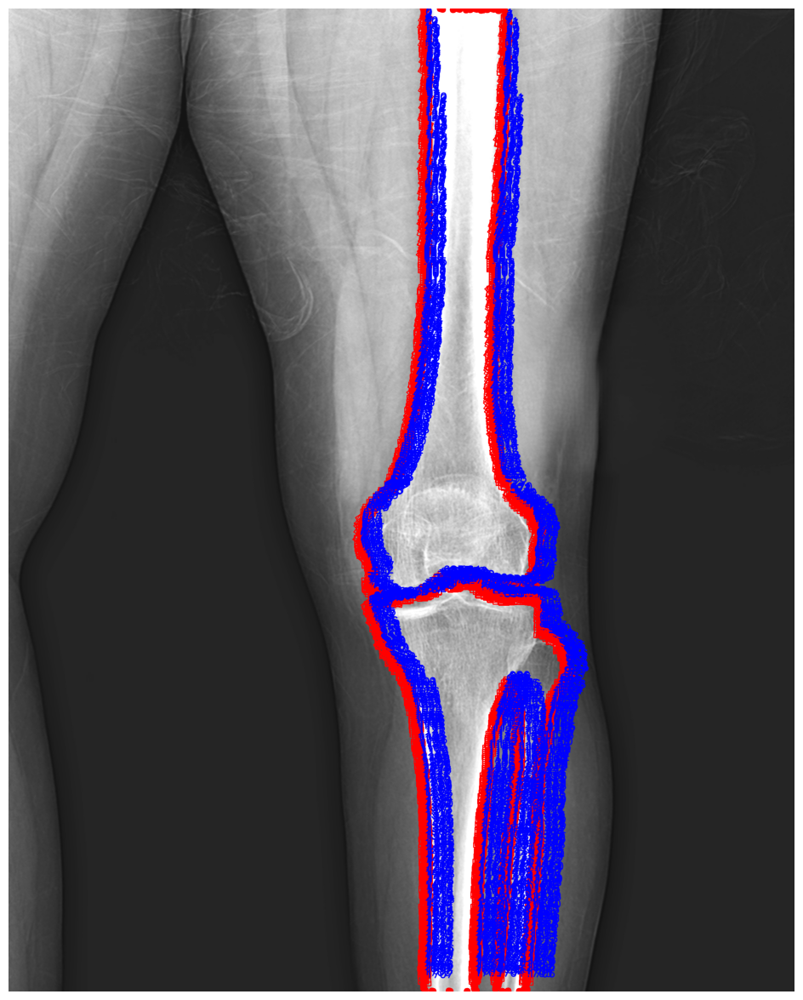

Toplam alınan patch sayısı: 1708


In [9]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x, y, PatchSize, np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs=EdgePatchsInfo)        
        
    total_patches = len(EdgePatchs)  # Toplam patch sayısını hesapla
    return EdgePatchs, EdgePatchsInfo, total_patches

# expanded_points --> img_EdgePatchs 
img_EdgePatchs, img_EdgePatchsInfo, total_patches = GetEdgePatchs(img, expanded_points, PatchSize=30, draw=True)  # M = 2*PatchSize + 1,  MxM = 101x101
print(f"Toplam alınan patch sayısı: {total_patches}")


In [14]:
#PACH LERİ GÖRSELLEŞTİRDİK (sadece ilk 100 pach görselleştirdik)

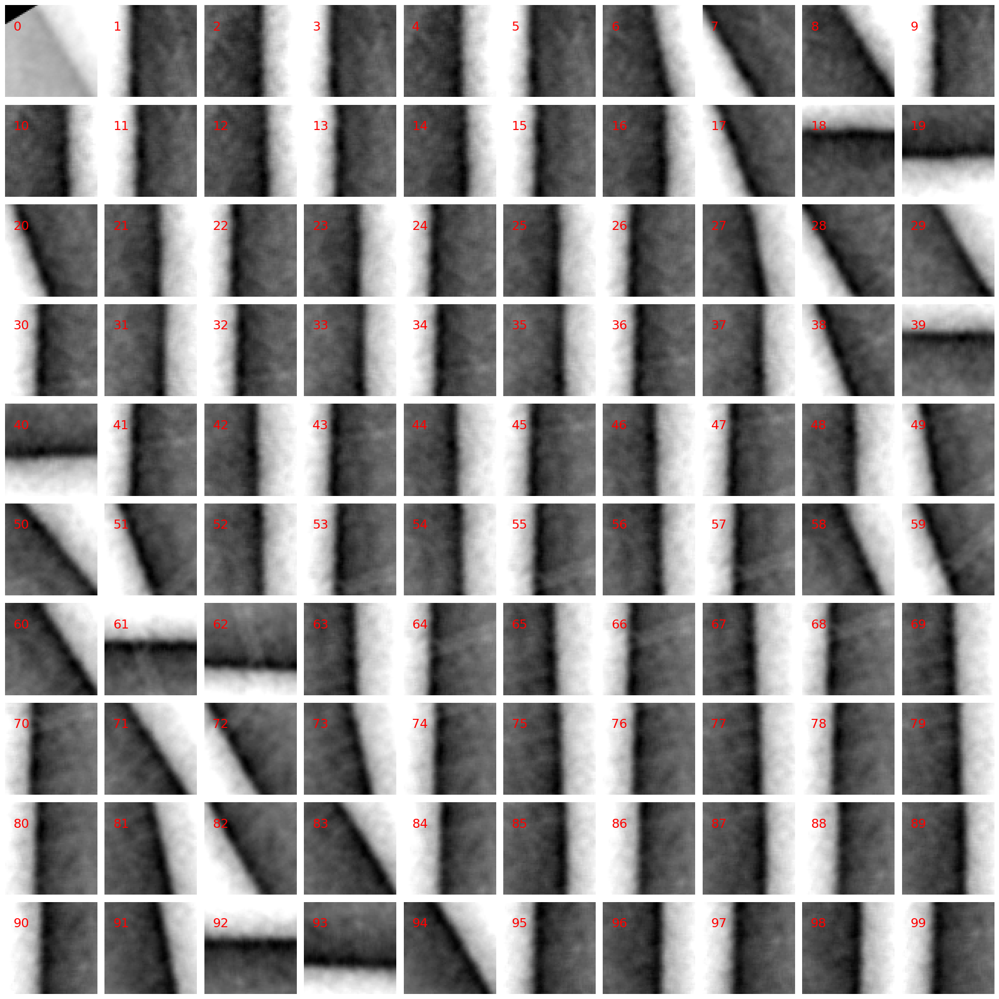

In [10]:
def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    # Toplam patch sayısı
    num_patches = min(len(EdgePatchs), max_patches)  # En fazla max_patches kadar göster
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()


# img_EdgePatchs gorsellerini tek figurede gör (ilk 100 patch)
DisplayPatches(img_EdgePatchs, max_patches=100)


In [16]:
#TÜM PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK

In [11]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")



# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png", cv2.IMREAD_GRAYSCALE)



# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\hog_features_with_coords.npz"
save_hog_features_with_coords(img_EdgePatchs, img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\hog_features_with_coords.npz
Toplam 1708 patch HOG ile kodlandı.


In [17]:
#TEST AŞAMASI

In [18]:
#TEST GÖRSELİNİ ÖN İŞLEMDEN GEÇİRİP GÖRÜNTÜLEDİK 
#BURDA DİKEY KEMİKLERDE DAHA ÇOK KENAR NOKTASI ÇIKARACAĞIMIZ EŞLEŞMENİN DAHA ÇOK OLACAĞINI DÜŞÜNDÜĞÜMÜZ İÇİN BU TEST GÖRSELİNİ SEÇTİK

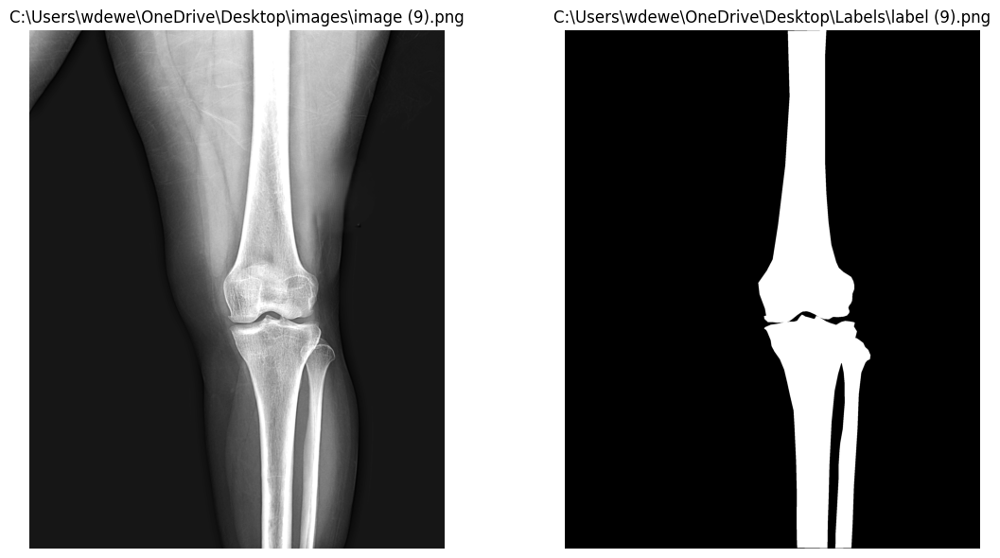

In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
test_img, test_label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png",
    draw=True
)


In [ ]:
#SOBEL İLE KENAR NOKTASI ÇIKARMA

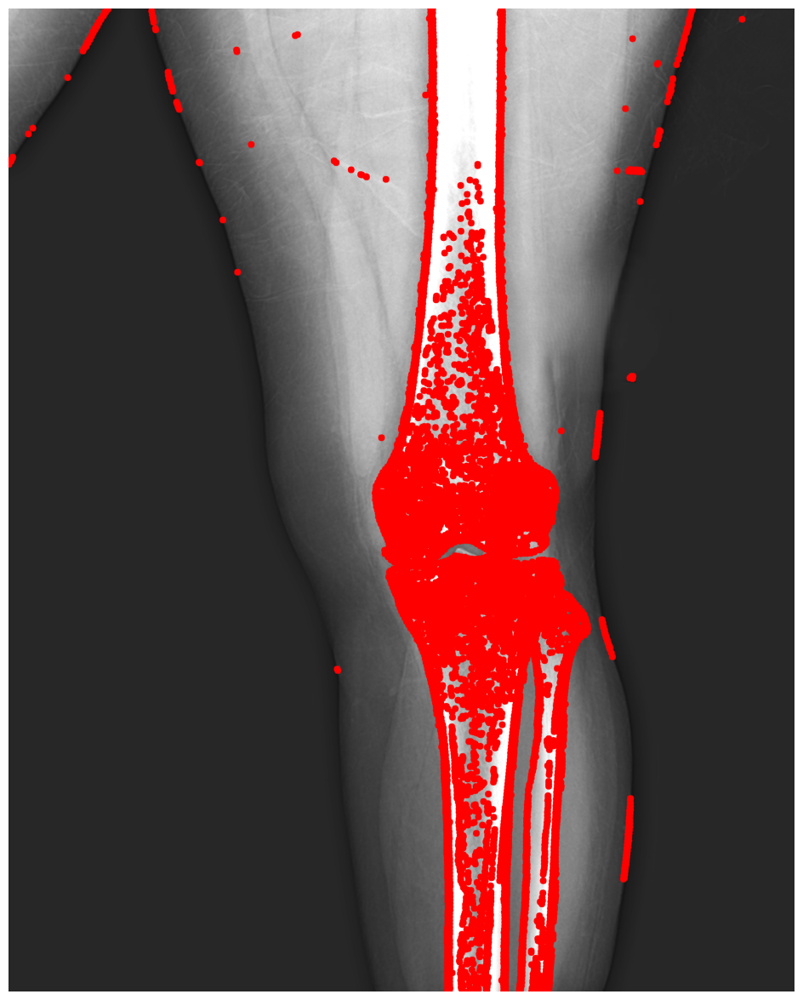

In [13]:
def GetSobelEdgePoints(img, sparsity_factor=1, draw=False):
    # Sobel filtrelerini uygula (yatay ve dikey gradyanlar)
    grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    
    # Gradyan büyüklüğünü hesapla
    grad_magnitude = cv2.magnitude(grad_x, grad_y)
    
    # Gradyan büyüklüğünü eşik değerine göre ikili görüntüye dönüştür
    _, edges = cv2.threshold(grad_magnitude, 50, 255, cv2.THRESH_BINARY)
    edges = edges.astype(np.uint8)
    
    # Kenar noktalarını bul
    SobelEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in SobelEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    return EdgePoints

# Sobel ile kenarları bulma
test_img_EdgePoints = GetSobelEdgePoints(test_img, sparsity_factor=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)


In [20]:
#CANNY İLE KENAR ÇIKARMA BU AŞAMADA CANNY DAHA BAŞARILI BUNU KULLANACAĞIZ

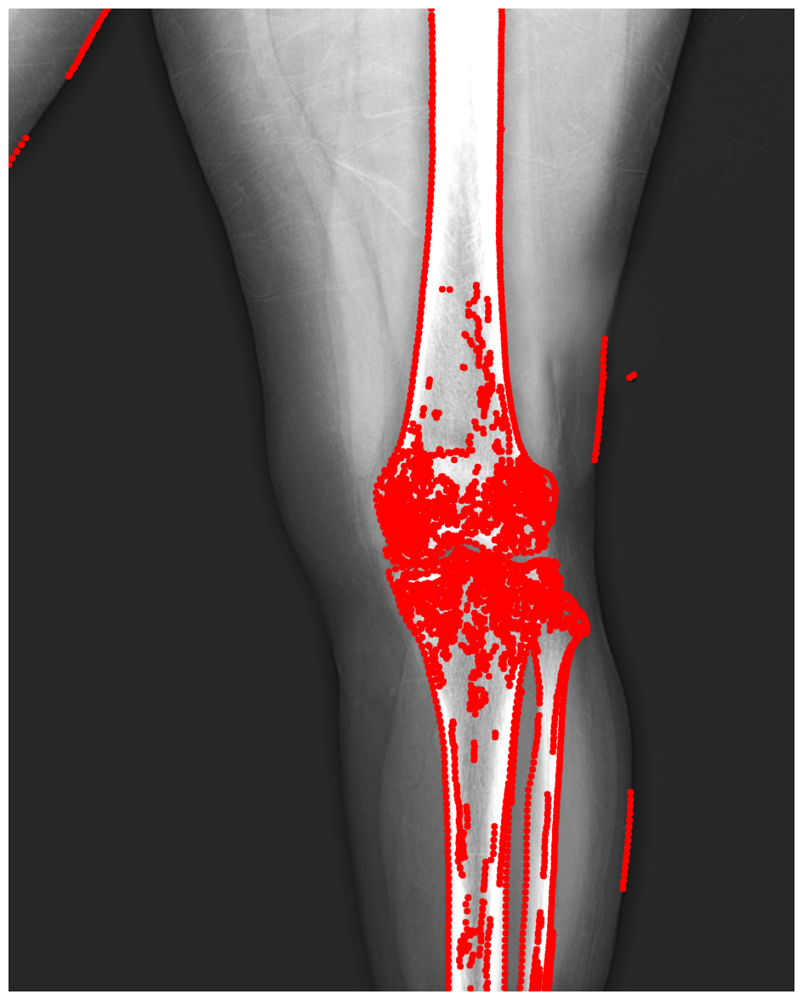

In [14]:
def GetCannyEdgePoints(img, sparsity_factor=1, draw=False):
    blurimg = cv2.GaussianBlur(img, (5, 5), 0)
    edges = cv2.Canny(blurimg, 25, 75)
    CannyEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in CannyEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    return EdgePoints

test_img_EdgePoints = GetCannyEdgePoints(test_img, sparsity_factor=20, draw=True)   # EdgePoints --> [p,2] --> (y,x)

Piramit oluşturma

In [17]:
# Görüntü piramidini oluştur
def create_image_pyramid(img, levels=3):
    pyramid = [img]
    for i in range(levels-1):
        img = cv2.pyrDown(img)
        pyramid.append(img)
    return pyramid

# Test görüntüsünü al ve piramit oluştur
test_img_pyramid = create_image_pyramid(test_img, levels=3)
test_img_level_1 = test_img_pyramid[0]  # İlk seviye (orijinal görüntü)

# Şimdi GetEdgePatchs fonksiyonunu çağır
try:
    test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(
        test_img_level_1, 
        test_img_EdgePoints, 
        PatchSize=20, 
        draw=True
    )
except Exception as e:
    print(f"Fonksiyon çalıştırma hatası: {e}")

Çizim hatası: not enough values to unpack (expected 4, got 3)


In [23]:
#BU NOKTALARDAN PACHLER ALDIK

In [19]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    
    # Görüntü boyutlarını bir kez al
    rows, cols = img.shape
    
    # Sınır kontrolü için minimum ve maksimum değerleri hesapla
    min_y, max_y = PatchSize, rows - PatchSize - 1
    min_x, max_x = PatchSize, cols - PatchSize - 1
    
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]
        
        # Hızlı sınır kontrolü
        if not (min_x <= x <= max_x and min_y <= y <= max_y):
            continue
            
        # Çizginin yönü - sadece gerekli noktaları al
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        
        # dx ve dy hesapla
        dx = x2 - x1
        dy = y2 - y1
        
        # Sıfır kontrolü
        if dx == 0 and dy == 0:
            continue
            
        # Açı hesapla
        angle = math.atan2(-dx, dy)
        
        try:
            # Patch al
            center = (float(x), float(y))
            rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
            rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), 
                                         flags=cv2.INTER_LINEAR, 
                                         borderMode=cv2.BORDER_CONSTANT, 
                                         borderValue=0)
            
            EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]
            
            # Patch boyut kontrolü
            if EdgePatch.shape != (2*PatchSize+1, 2*PatchSize+1):
                continue
                
            EdgePatchs.append(EdgePatch)
            # Açı bilgisini de ekle
            EdgePatchsInfo.append([x, y, PatchSize, np.degrees(angle)])
            
            # Bellek optimizasyonu için liste boyutu kontrolü
            if len(EdgePatchs) > 1000:  # Maksimum patch sayısı
                break
                
        except Exception as e:
            print(f"Hata oluştu: {e}")
            continue
    
    if draw and EdgePatchsInfo:  # EdgePatchsInfo boş değilse çiz
        try:
            Drawing(img, EdgePoints=EdgePoints, EdgePatchs=EdgePatchsInfo)
        except Exception as e:
            print(f"Çizim hatası: {e}")
    
    return EdgePatchs, EdgePatchsInfo

In [26]:
#ALDIĞIMIZ PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK (Toplam 3893 patch HOG ile kodlandı.)

In [20]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")

# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png", cv2.IMREAD_GRAYSCALE)

# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\test_image9_hog_features_with_coords.npz"
save_hog_features_with_coords(test_img_EdgePatchs, test_img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(test_img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\test_image9_hog_features_with_coords.npz
Toplam 1001 patch HOG ile kodlandı.


In [28]:
#DOSYADA Kİ KAYITLI KLASÖRÜN ANAHTARINI SORGULAYAN KOD

In [21]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\test_image9_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['features', 'coords']


In [29]:
#HOG KODLARINI CROSS KOLERASYONLA KARŞILAŞTIRDIK.

In [23]:
# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    # Vektör boyutlarını kontrol et ve yazdır
    print(f"Vectors1 shape: {vectors1.shape}")
    print(f"Vectors2 shape: {vectors2.shape}")
    
    # Vektörlerin boyutlarını eşitle
    min_features = min(vectors1.shape[1], vectors2.shape[1])
    vectors1 = vectors1[:, :min_features]
    vectors2 = vectors2[:, :min_features]
    
    return 1 - cdist(vectors1, vectors2, metric='correlation')

# Korelasyon hesaplama kısmında
try:
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)
except Exception as e:
    print(f"Korelasyon hesaplama hatası: {e}")
    print(f"Test HOG vektör boyutu: {test_hog_vectors.shape}")
    print(f"Stored HOG vektör boyutu: {stored_hog_vectors.shape}")

Vectors1 shape: (1001, 576)
Vectors2 shape: (1708, 1296)


In [24]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png"
]

label_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png"
]

hog_files = [
    r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_4\test_image9_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
output_images = []  # Sonuç görsellerini tutmak için bir liste oluştur
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    # Test HOG vektörlerini ve koordinatlarını yükleme
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['features']
    test_coords = hog_data['coords']
    
    # Test görüntüsünü yükleme
    test_image = cv2.imread(test_image_path)
    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma
    
    # Etiket görüntüsünü yükleme
    label_image = cv2.imread(label_image_path)

    # Çapraz korelasyonu hızlı hesaplama
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, stored_idx in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        matching_coords_count += 1
    
    # Görüntü adını dosya yolundan çıkarma
    image_name = test_image_path.split("\\")[-1]
    
    # Sonuç görselini output_images listesine ekleme
    output_images.append(output_img)
    
    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output_test_img{idx + 6} (Eşleşme Sayısı: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Sonuç görsellerini bir değişkende tutma
final_output_image = output_images[-1]  # Son görseli tutan değişken


ValueError: XA and XB must have the same number of columns (i.e. feature dimension.)

<Figure size 1500x500 with 0 Axes>

In [32]:
#FİNAL GÖRÜNTÜSÜNE MORFOLOJİK MÜDAHALELER

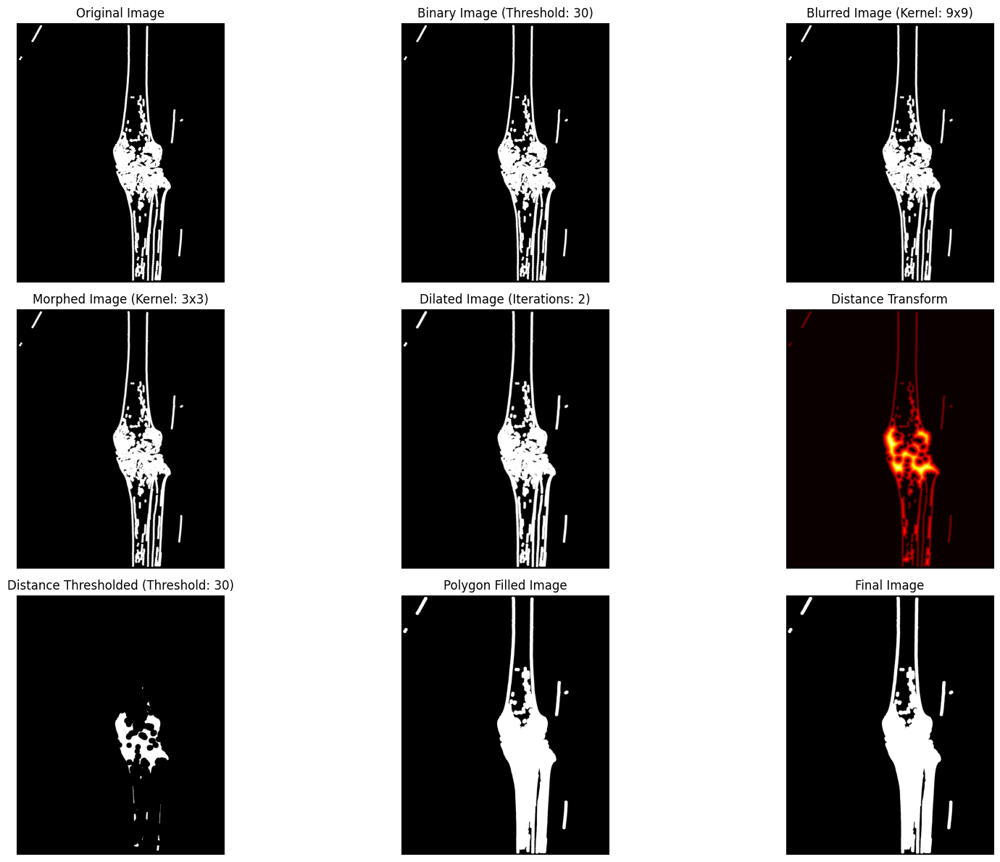

In [54]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme ve gri tonlamaya dönüştürme
if isinstance(final_output_image, np.ndarray):
    if len(final_output_image.shape) == 3:  # Eğer görüntü renkli ise gri tonlamaya dönüştür
        image = cv2.cvtColor(final_output_image, cv2.COLOR_BGR2GRAY)
    else:
        image = final_output_image  # Zaten gri tonlamalı
else:
    image = cv2.imread(final_output_image, cv2.IMREAD_GRAYSCALE)

if image is None:
    raise ValueError("Görüntü yüklenemedi. Lütfen doğru yolu kontrol edin veya geçerli bir NumPy dizisi kullanın.")

# --- Ayarlanabilir Eşik Değerleri ---
threshold_value_initial = 30  # İlk eşik değeri (örneğin kenar tespiti için)
blur_kernel_size = 9          # Bulanıklaştırma için kernel boyutu
morph_kernel_size = 3         # Morfolojik işlemler için kernel boyutu
dilate_iterations = 2        # Dilatasyon iterasyon sayısı
distance_threshold_value = 30 # Distance transform için eşik değeri

# --- Kenarları Tespit Etme ---
_, binary_image = cv2.threshold(image, threshold_value_initial, 255, cv2.THRESH_BINARY)

# --- Bulanıklaştırma ---
blurred_image = cv2.GaussianBlur(binary_image, (blur_kernel_size, blur_kernel_size), 0)

# --- Morfolojik İşlemler: Closing ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (morph_kernel_size, morph_kernel_size))
morphed_image = cv2.morphologyEx(blurred_image, cv2.MORPH_CLOSE, kernel)

# --- Dilatasyon ile Noktaları Birleştirme ---
dilated_image = cv2.dilate(morphed_image, kernel, iterations=dilate_iterations)

# --- Distance Transform ---
distance_transform = cv2.distanceTransform(dilated_image, cv2.DIST_L2, 5)
_, distance_thresholded = cv2.threshold(distance_transform, distance_threshold_value, 255, cv2.THRESH_BINARY)
distance_thresholded = distance_thresholded.astype(np.uint8)

# --- Bağlantılı Bileşen Analizi ---
num_labels, labels_im = cv2.connectedComponents(distance_thresholded)

# --- Konturları Bulma ve Poligon Oluşturma ---
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
polygon_image = np.zeros_like(dilated_image)

for contour in contours:
    # Konturların içini beyaz yap (poligon şekli)
    cv2.fillPoly(polygon_image, [contour], 255)

# Poligon içindeki alanları beyaz yap
final_image = cv2.bitwise_or(dilated_image, polygon_image)

# --- Sonuçları Görselleştirme ---
plt.figure(figsize=(18, 12))

# Orijinal Görüntü
plt.subplot(3, 3, 1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

# İlk Eşiklenmiş Görüntü
plt.subplot(3, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title(f"Binary Image (Threshold: {threshold_value_initial})")
plt.axis('off')

# Bulanıklaştırılmış Görüntü
plt.subplot(3, 3, 3)
plt.imshow(blurred_image, cmap='gray')
plt.title(f"Blurred Image (Kernel: {blur_kernel_size}x{blur_kernel_size})")
plt.axis('off')

# Morfolojik İşlemler Sonrası Görüntü
plt.subplot(3, 3, 4)
plt.imshow(morphed_image, cmap='gray')
plt.title(f"Morphed Image (Kernel: {morph_kernel_size}x{morph_kernel_size})")
plt.axis('off')

# Dilatasyon Sonrası Görüntü
plt.subplot(3, 3, 5)
plt.imshow(dilated_image, cmap='gray')
plt.title(f"Dilated Image (Iterations: {dilate_iterations})")
plt.axis('off')

# Distance Transform Sonrası Görüntü
plt.subplot(3, 3, 6)
plt.imshow(distance_transform, cmap='hot')
plt.title("Distance Transform")
plt.axis('off')

# Distance Threshold Sonrası Görüntü
plt.subplot(3, 3, 7)
plt.imshow(distance_thresholded, cmap='gray')
plt.title(f"Distance Thresholded (Threshold: {distance_threshold_value})")
plt.axis('off')

# Poligon İçinde Beyaz Alanlar
plt.subplot(3, 3, 8)
plt.imshow(polygon_image, cmap='gray')
plt.title("Polygon Filled Image")
plt.axis('off')

# Final Görüntü
plt.subplot(3, 3, 9)
plt.imshow(final_image, cmap='gray')
plt.title("Final Image")
plt.axis('off')

plt.tight_layout()
plt.show()



In [55]:
#IoU HESAPLAMA

Final Image IoU: 0.6185


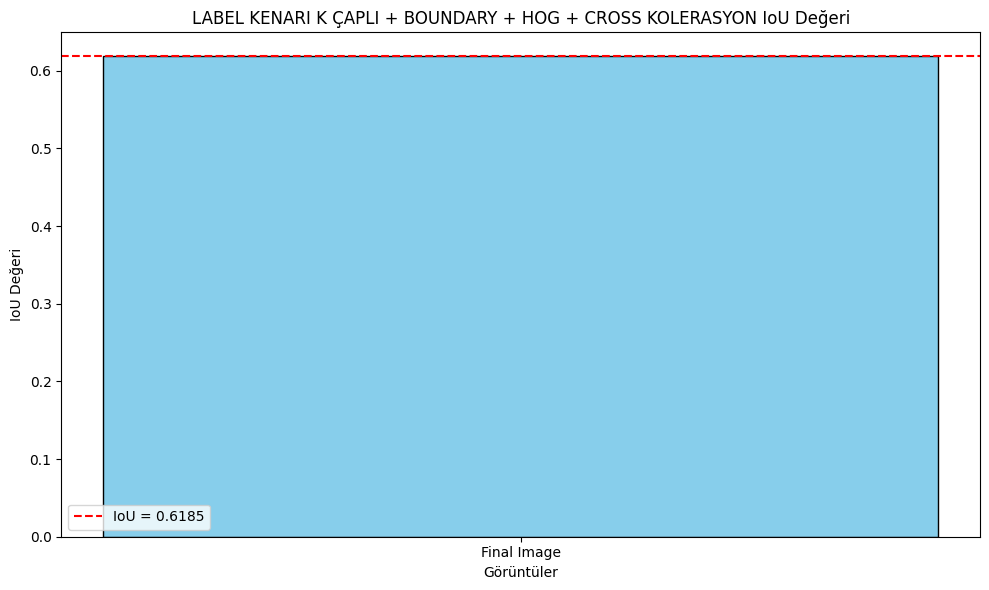

In [56]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(predicted_image, 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# final_image'i kontrol etme
if final_image is None:
    print("Final görüntüsü yüklenemedi!")
else:
    # Eğer final_image zaten gri tonlamalıysa, doğrudan eşikleme yapabilirsiniz
    _, final_binary = cv2.threshold(final_image, 127, 255, cv2.THRESH_BINARY)

# Etiket görüntüsünü yükleme ve kontrol etme
label_image = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png", cv2.IMREAD_GRAYSCALE)  # Etiket görüntüsünün yolu buraya girilmeli
if label_image is None:
    print("Etiket görüntüsü yüklenemedi!")
else:
    # Etiket görüntüsünü ikili hale getirme
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)


# IoU hesaplama
if final_image is not None and label_image is not None:
    iou = calculate_iou(final_binary, label_binary)
    print(f"Final Image IoU: {iou:.4f}")

    # IoU Grafik Çıktısı
    plt.figure(figsize=(10, 6))
    plt.bar(["Final Image"], [iou], color='skyblue', edgecolor='black')
    plt.axhline(iou, color='red', linestyle='--', label=f"IoU = {iou:.4f}")
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('LABEL KENARI K ÇAPLI + BOUNDARY + HOG + CROSS KOLERASYON IoU Değeri')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [1]:
##############################################################################################################################################

In [2]:
#(4_1 MADDE) GÖRÜNTÜ KENAR ÇİZGİLERİ + BOUNDARY + HOG + SOBEL NOKTA +  CROSS KOLERASYON + IoU(%70 BENZERLİK YAKALADIK) Final Image IoU: 0.7020

#HER GÖRÜNTÜDEN BOUNDARY İLE ALDIĞIMIZ KENAR NOKTALARI YARDIMIYLA BULDUĞUMUZ 15 PİKSELLİK ÇİZGİLERDEN ALDIĞIMIZ PACHLERİ HOG İLE KODLADIK
#KODLANAN BU HOG KODLARI İLE TEST GÖRSELİNİN HOG KODLARINI CROSS KOLERASYON YARDIMI İLE KARŞILAŞTIRDIK EŞLEŞEN NOKTALARI İŞARETLEDİK
#SON OLARAK MORFOLOJİK OPERASYONLARDAN GEÇİRİP IoU HESAPLADIK
#BU KODUN TEST AŞAMASINDA CANNY YERİNE SOBELLE KENAR NOKTA TESPİTİ YAPTIK DAHA BAŞARILI OLDUĞUNU GÖRDÜK.

In [3]:
#MODELLEME AŞAMASI

In [4]:
#KÜTÜPHANELERİ İMPORT EDİYORUZ

In [25]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
import importlib
import utils
importlib.reload(utils)
from utils import *

In [6]:
#EĞİTİM GÖRSELİ VE LABELLERİ ÖN İŞLEMDEN GEÇİRİLEREK GÖRSELLEŞTİRİLİYOR

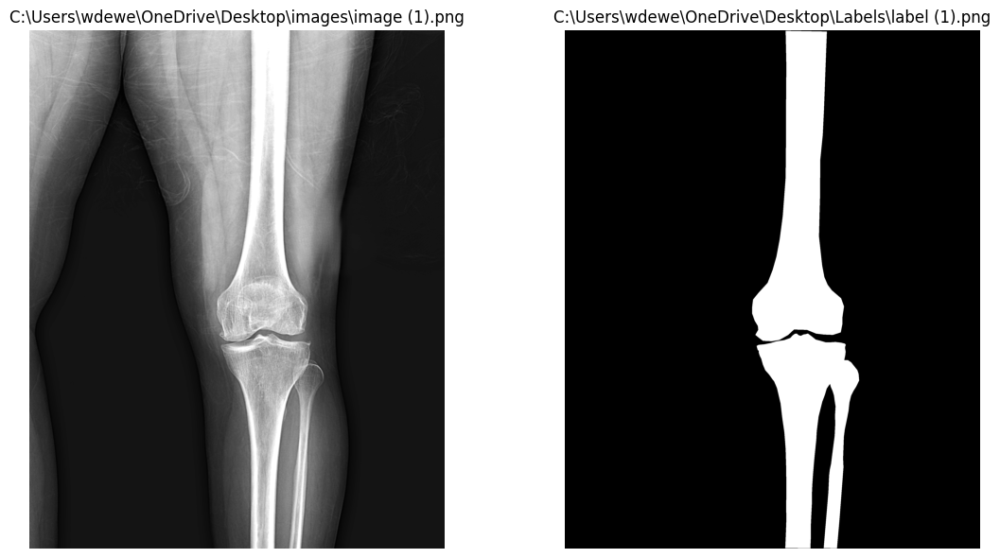

In [26]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
img, label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (1).png",
    draw=True
)


In [8]:
#YAZDIRMA KODLARI

In [27]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()  

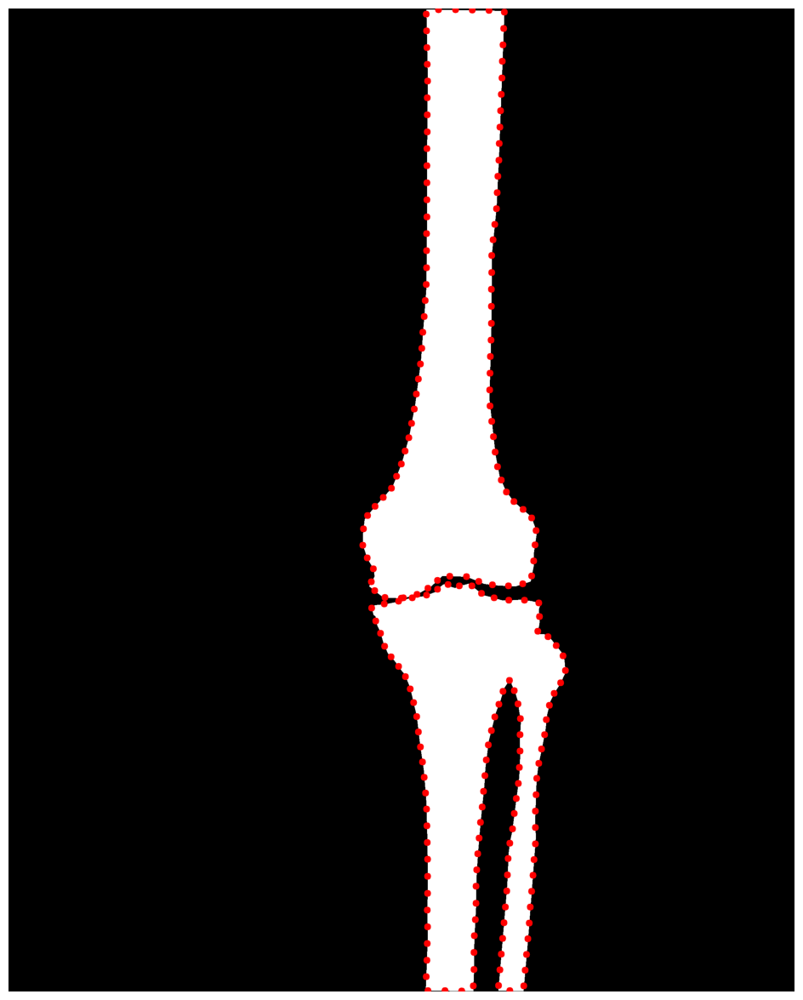

In [28]:
def GetLabelEdgePoints(img, sparsity_factor=1, circle_radius = 10, draw=False):
    contours = measure.find_contours(img, level=0.5)
    # Tüm sınır piksellerini birleştir
    boundary_points = np.vstack(contours)
    
    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        boundary_points = boundary_points[::sparsity_factor]
        
    if draw:
        Drawing(img, EdgePoints=boundary_points, circle_radius=circle_radius)

    return boundary_points.astype(int)

# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=50, circle_radius=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)

In [11]:
#LABEL VE BOUNDARY İLE KENAR NOKTALARINDAN 15 PİKSELLİK ÇİZGİLER ELDE ETTİK (15 PİKSELLİK ÇİZGİLER BOYUNCA PACHLER ALDIK)

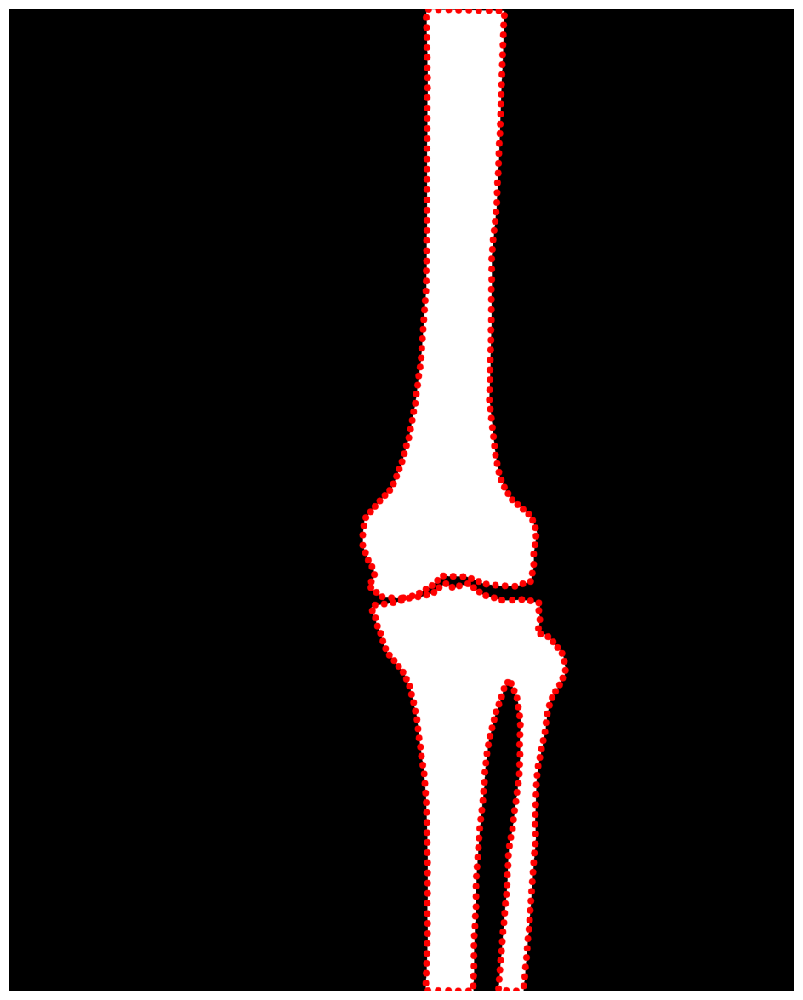

C:\Users\wdewe\AppData\Local\Temp\ipykernel_5320\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


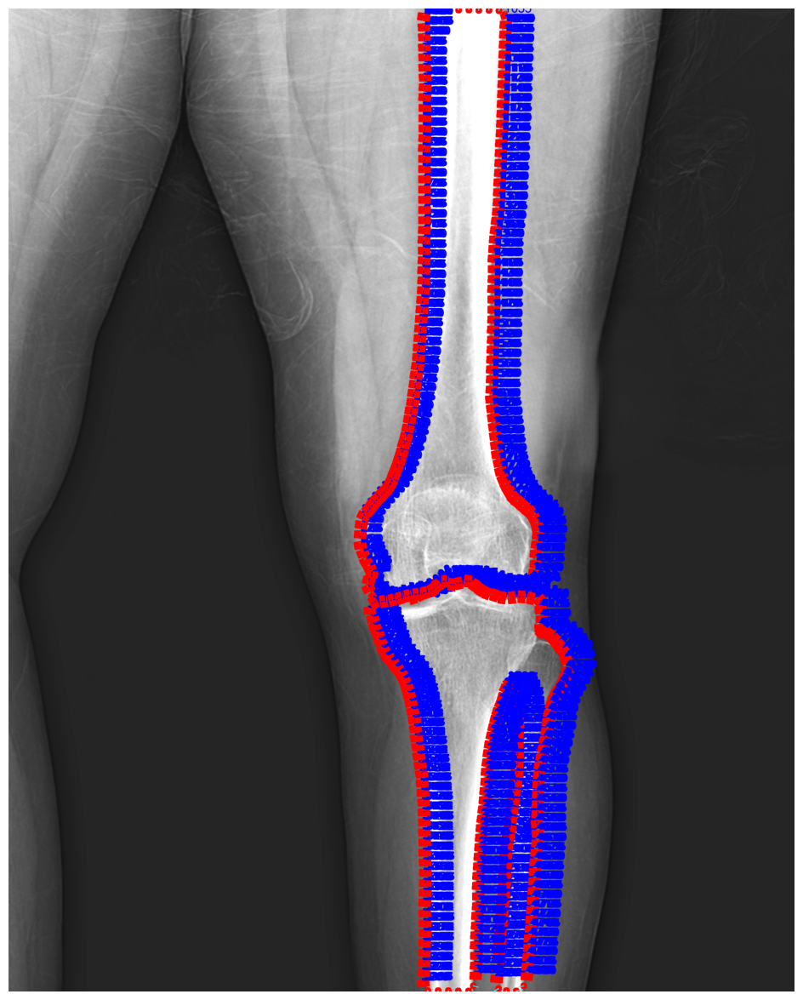

In [29]:
def GetLabelEdgePoints(img, sparsity_factor=1, circle_radius = 10, draw=False):
    contours = measure.find_contours(img, level=0.5)
    # Tüm sınır piksellerini birleştir
    boundary_points = np.vstack(contours)
    
    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        boundary_points = boundary_points[::sparsity_factor]
        
    if draw:
        Drawing(img, EdgePoints=boundary_points, circle_radius=circle_radius)

    return boundary_points.astype(int)

# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=30, circle_radius=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)

def GetLinePatchs(img, EdgePoints, LineLength=15, PatchSize=11, draw=True):
    LinePatchs = []
    LinePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Kenar noktasının koordinatları
        y, x = EdgePoints[i]

        # Çizginin yönü: Beyaz alana doğru
        # Önceki ve sonraki kenar noktasını alıp yönü hesapla
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)  # Çizginin yönünü hesapla

        # Çizginin başından 15 piksel uzaklıkta bir hedef nokta
        line_end_x = x + LineLength * math.cos(angle)
        line_end_y = y + LineLength * math.sin(angle)
        
        # Çizgiyi oluştur
        line_points = []
        for t in range(LineLength):
            line_x = int(x + t * math.cos(angle))
            line_y = int(y + t * math.sin(angle))
            if 0 <= line_x < img.shape[1] and 0 <= line_y < img.shape[0]:
                line_points.append((line_y, line_x))
        
        # Çizgi üzerinde her bir noktadan patch al
        for point in line_points:
            line_y, line_x = point

            # Patch al
            y_start, y_end = line_y - PatchSize, line_y + PatchSize + 1
            x_start, x_end = line_x - PatchSize, line_x + PatchSize + 1

            if y_start < 0 or y_end > img.shape[0] or x_start < 0 or x_end > img.shape[1]:
                continue  # Patch sınırların dışında, atla

            LinePatch = img[line_y - PatchSize:line_y + PatchSize + 1, line_x - PatchSize:line_x + PatchSize + 1]
            LinePatchs.append(LinePatch)
            LinePatchsInfo.append([line_x, line_y, PatchSize, np.degrees(angle)])
    
    if draw:
        # Çizgileri görselleştir
        EdgeLines = []
        for i in range(len(EdgePoints)):
            y, x = EdgePoints[i]
            prev_idx = (i - 1) % len(EdgePoints)
            next_idx = (i + 1) % len(EdgePoints)
            y1, x1 = EdgePoints[prev_idx]
            y2, x2 = EdgePoints[next_idx]
            dx = x2 - x1
            dy = y2 - y1
            if dx == 0 and dy == 0:
                continue  
            angle = math.atan2(-dx, dy)  # Çizginin yönünü hesapla

            # Çizginin başından 15 piksel uzaklıkta bir hedef nokta
            line_end_x = x + LineLength * math.cos(angle)
            line_end_y = y + LineLength * math.sin(angle)
            
            start_point = (x, y)
            stop_point = (int(line_end_x), int(line_end_y))
            EdgeLines.append({"StartPointYX": (y, x), "StopPointYX": (int(line_end_y), int(line_end_x))})
        
        # Görselleştirme
        Drawing(img, EdgePoints=EdgePoints, EdgeLines=EdgeLines, EdgePatchs=LinePatchsInfo)

    return LinePatchs, LinePatchsInfo

# Kenar noktalarından beyaz alana doğru çizgiler çiz ve patch'ler al
img_LinePatchs, img_LinePatchsInfo = GetLinePatchs(img, img_EdgePoints, LineLength=15, PatchSize=20, draw=True)


In [13]:
#PACH LERİ GÖRSELLEŞTİRDİK (15 PİKSELLİK ÇİZGİLER BOYUNCA PACHLER ALDIK)

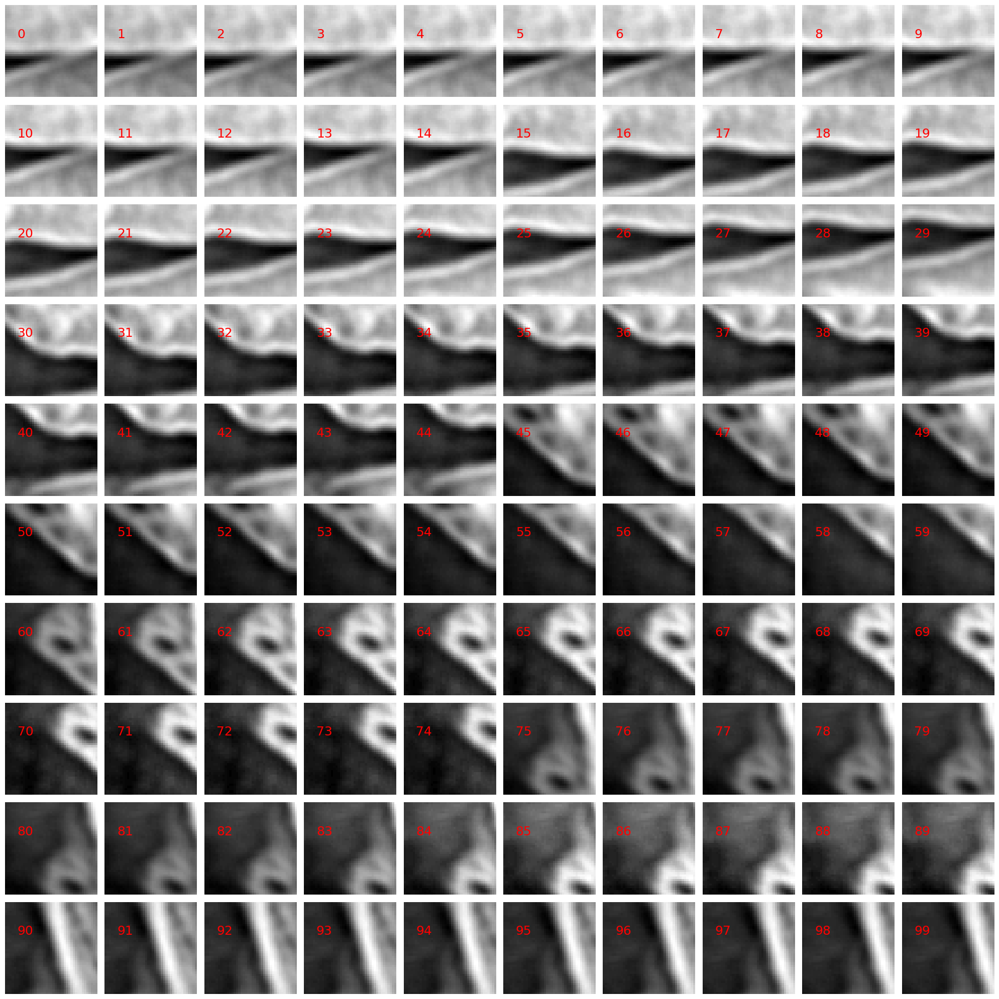

In [30]:
def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    # Toplam patch sayısı
    num_patches = min(len(EdgePatchs), max_patches)  # En fazla max_patches kadar göster
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()


# img_LinePatchs gorsellerini tek figurede gör (ilk 100 patch)
DisplayPatches(img_LinePatchs, max_patches=100)


In [15]:
#TÜM PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK Toplam 4831 patch HOG ile kodlandı.

In [31]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")



# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png", cv2.IMREAD_GRAYSCALE)



# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\hog_features_with_coords.npz"
save_hog_features_with_coords(img_LinePatchs, img_LinePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(img_LinePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\hog_features_with_coords.npz
Toplam 4831 patch HOG ile kodlandı.


In [18]:
#TEST AŞAMASI

In [19]:
#TEST GÖRSELİNİ ÖN İŞLEMDEN GEÇİRİP GÖRÜNTÜLEDİK

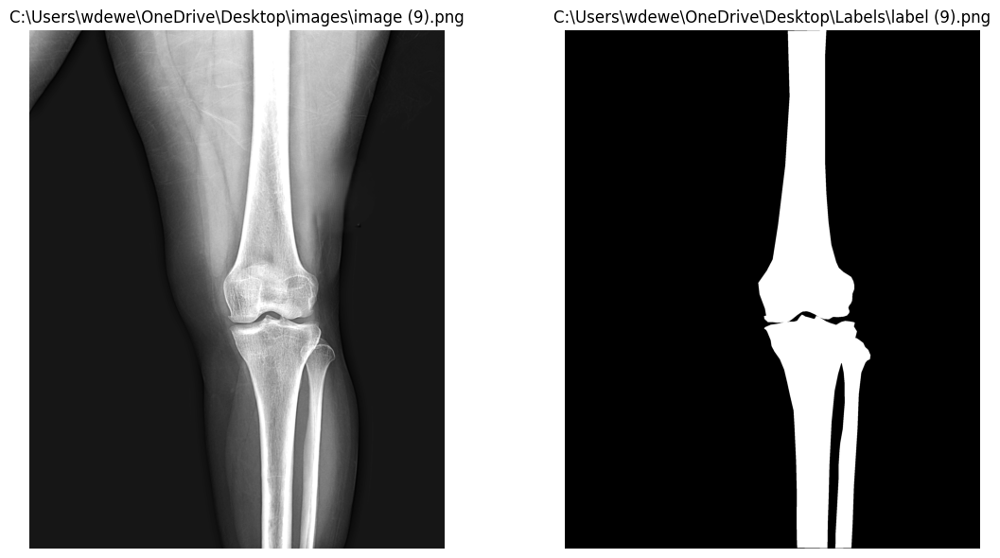

In [32]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
test_img, test_label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png",
    draw=True
)


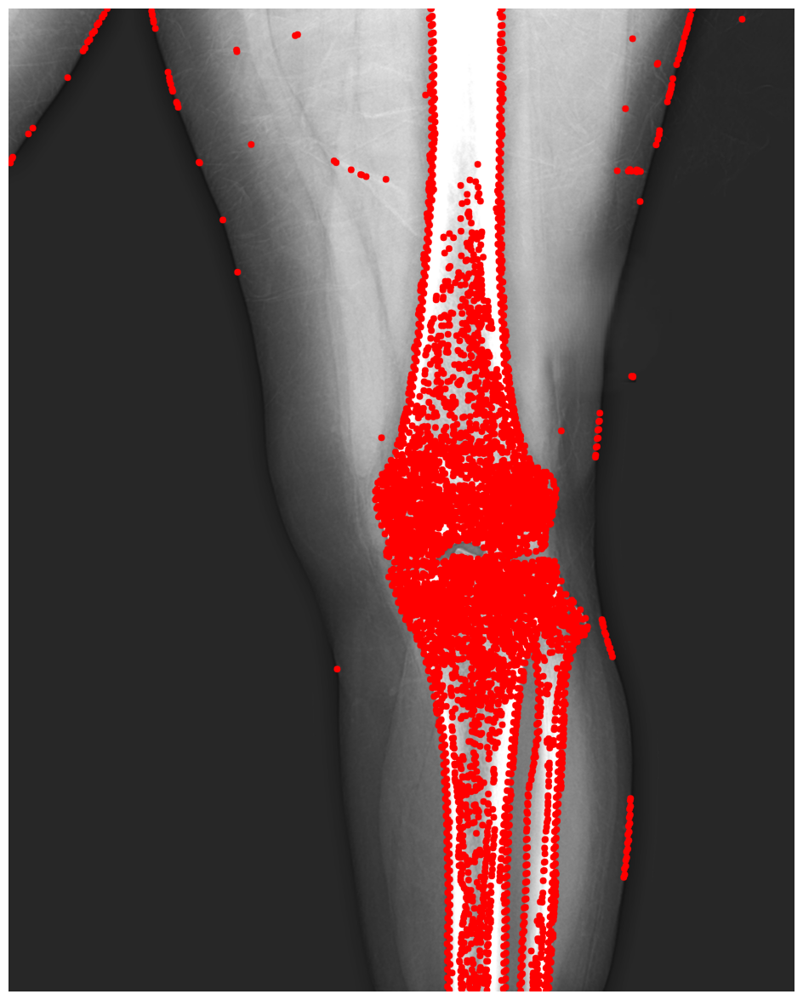

Toplam Kenar Noktası Sayısı: 5210


In [33]:
def GetSobelEdgePoints(img, sparsity_factor=1, draw=False):
    # Sobel filtrelerini uygula (yatay ve dikey gradyanlar)
    grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    
    # Gradyan büyüklüğünü hesapla
    grad_magnitude = cv2.magnitude(grad_x, grad_y)
    
    # Gradyan büyüklüğünü eşik değerine göre ikili görüntüye dönüştür
    _, edges = cv2.threshold(grad_magnitude, 50, 255, cv2.THRESH_BINARY)
    edges = edges.astype(np.uint8)
    
    # Kenar noktalarını bul
    SobelEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in SobelEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    print(f"Toplam Kenar Noktası Sayısı: {len(EdgePoints)}")  # Nokta sayısını yazdır
    return EdgePoints

# Sobel ile kenarları bulma
test_img_EdgePoints = GetSobelEdgePoints(test_img, sparsity_factor=25, draw=True)   # EdgePoints --> [p,2] --> (y,x)


In [26]:
#BU NOKTALARDAN PACHLER ALDIK

In [34]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo


test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=20, draw=True)

: 

In [27]:
#ALDIĞIMIZ PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK (Toplam 5169 patch HOG ile kodlandı..)

In [ ]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")

# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png", cv2.IMREAD_GRAYSCALE)

# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\test_image9_hog_features_with_coords.npz"
save_hog_features_with_coords(test_img_EdgePatchs, test_img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(test_img_EdgePatchs)} patch HOG ile kodlandı.")


In [28]:
#DOSYADA Kİ KAYITLI KLASÖRÜN ANAHTARINI SORGULAYAN KOD

In [30]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\test_image9_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['features', 'coords']


In [ ]:
#HOG KODLARINI CROSS KOLERASYONLA KARŞILAŞTIRDIK.

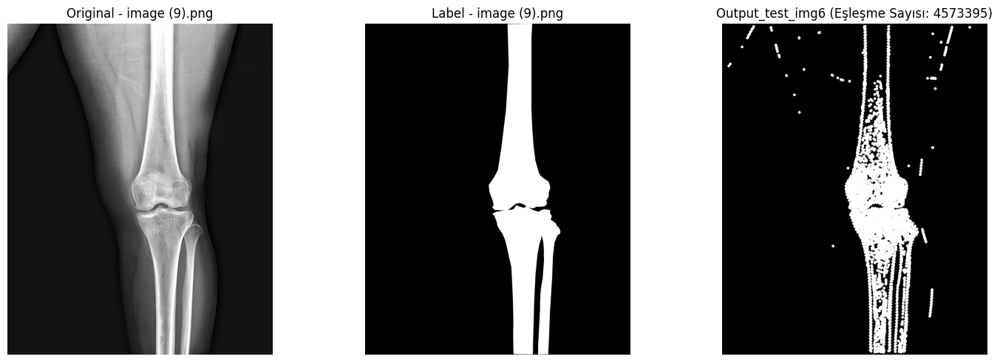

In [31]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png"
]

label_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png"
]

hog_files = [
    r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_1\test_image9_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
output_images = []  # Sonuç görsellerini tutmak için bir liste oluştur
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    # Test HOG vektörlerini ve koordinatlarını yükleme
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['features']
    test_coords = hog_data['coords']
    
    # Test görüntüsünü yükleme
    test_image = cv2.imread(test_image_path)
    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma
    
    # Etiket görüntüsünü yükleme
    label_image = cv2.imread(label_image_path)

    # Çapraz korelasyonu hızlı hesaplama
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, stored_idx in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        matching_coords_count += 1
    
    # Görüntü adını dosya yolundan çıkarma
    image_name = test_image_path.split("\\")[-1]
    
    # Sonuç görselini output_images listesine ekleme
    output_images.append(output_img)
    
    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output_test_img{idx + 6} (Eşleşme Sayısı: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Sonuç görsellerini bir değişkende tutma
final_output_image = output_images[-1]  # Son görseli tutan değişken


In [32]:
#FİNAL GÖRÜNTÜSÜNE MORFOLOJİK MÜDAHALELER

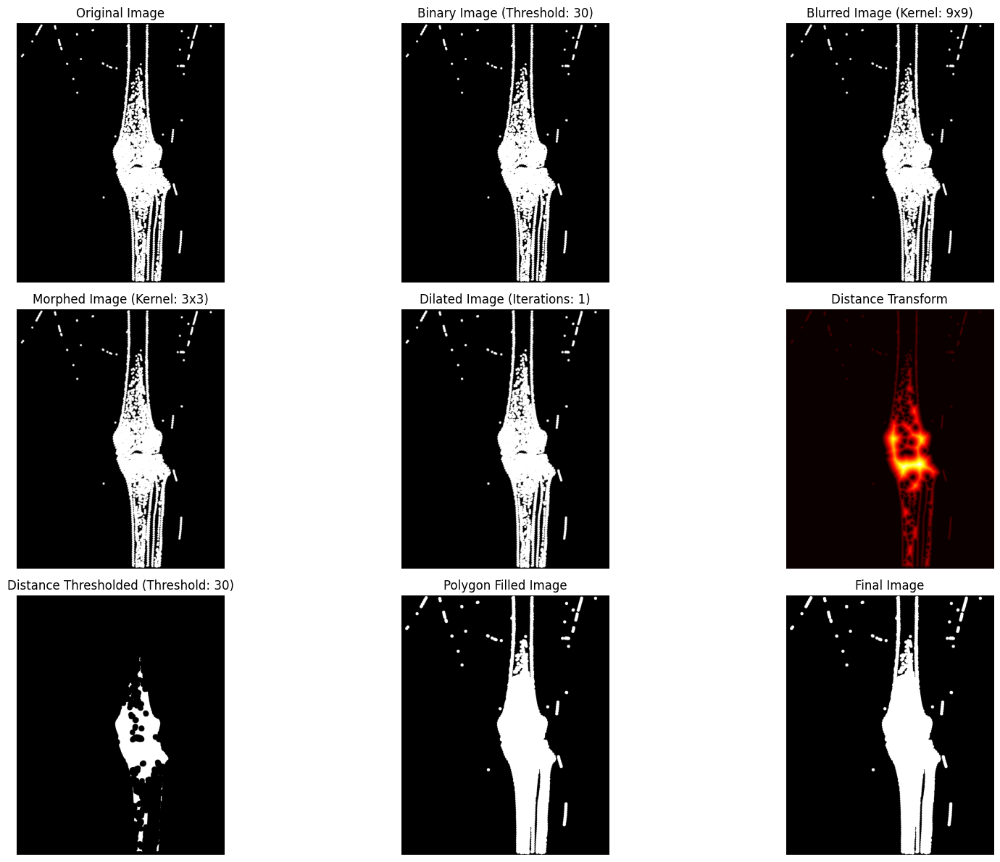

In [43]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme ve gri tonlamaya dönüştürme
if isinstance(final_output_image, np.ndarray):
    if len(final_output_image.shape) == 3:  # Eğer görüntü renkli ise gri tonlamaya dönüştür
        image = cv2.cvtColor(final_output_image, cv2.COLOR_BGR2GRAY)
    else:
        image = final_output_image  # Zaten gri tonlamalı
else:
    image = cv2.imread(final_output_image, cv2.IMREAD_GRAYSCALE)

if image is None:
    raise ValueError("Görüntü yüklenemedi. Lütfen doğru yolu kontrol edin veya geçerli bir NumPy dizisi kullanın.")

# --- Ayarlanabilir Eşik Değerleri ---
threshold_value_initial = 30  # İlk eşik değeri (örneğin kenar tespiti için)
blur_kernel_size = 9          # Bulanıklaştırma için kernel boyutu
morph_kernel_size = 3         # Morfolojik işlemler için kernel boyutu
dilate_iterations = 1        # Dilatasyon iterasyon sayısı
distance_threshold_value = 30 # Distance transform için eşik değeri

# --- Kenarları Tespit Etme ---
_, binary_image = cv2.threshold(image, threshold_value_initial, 255, cv2.THRESH_BINARY)

# --- Bulanıklaştırma ---
blurred_image = cv2.GaussianBlur(binary_image, (blur_kernel_size, blur_kernel_size), 0)

# --- Morfolojik İşlemler: Closing ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (morph_kernel_size, morph_kernel_size))
morphed_image = cv2.morphologyEx(blurred_image, cv2.MORPH_CLOSE, kernel)

# --- Dilatasyon ile Noktaları Birleştirme ---
dilated_image = cv2.dilate(morphed_image, kernel, iterations=dilate_iterations)

# --- Distance Transform ---
distance_transform = cv2.distanceTransform(dilated_image, cv2.DIST_L2, 5)
_, distance_thresholded = cv2.threshold(distance_transform, distance_threshold_value, 255, cv2.THRESH_BINARY)
distance_thresholded = distance_thresholded.astype(np.uint8)

# --- Bağlantılı Bileşen Analizi ---
num_labels, labels_im = cv2.connectedComponents(distance_thresholded)

# --- Konturları Bulma ve Poligon Oluşturma ---
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
polygon_image = np.zeros_like(dilated_image)

for contour in contours:
    # Konturların içini beyaz yap (poligon şekli)
    cv2.fillPoly(polygon_image, [contour], 255)

# Poligon içindeki alanları beyaz yap
final_image = cv2.bitwise_or(dilated_image, polygon_image)

# --- Sonuçları Görselleştirme ---
plt.figure(figsize=(18, 12))

# Orijinal Görüntü
plt.subplot(3, 3, 1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

# İlk Eşiklenmiş Görüntü
plt.subplot(3, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title(f"Binary Image (Threshold: {threshold_value_initial})")
plt.axis('off')

# Bulanıklaştırılmış Görüntü
plt.subplot(3, 3, 3)
plt.imshow(blurred_image, cmap='gray')
plt.title(f"Blurred Image (Kernel: {blur_kernel_size}x{blur_kernel_size})")
plt.axis('off')

# Morfolojik İşlemler Sonrası Görüntü
plt.subplot(3, 3, 4)
plt.imshow(morphed_image, cmap='gray')
plt.title(f"Morphed Image (Kernel: {morph_kernel_size}x{morph_kernel_size})")
plt.axis('off')

# Dilatasyon Sonrası Görüntü
plt.subplot(3, 3, 5)
plt.imshow(dilated_image, cmap='gray')
plt.title(f"Dilated Image (Iterations: {dilate_iterations})")
plt.axis('off')

# Distance Transform Sonrası Görüntü
plt.subplot(3, 3, 6)
plt.imshow(distance_transform, cmap='hot')
plt.title("Distance Transform")
plt.axis('off')

# Distance Threshold Sonrası Görüntü
plt.subplot(3, 3, 7)
plt.imshow(distance_thresholded, cmap='gray')
plt.title(f"Distance Thresholded (Threshold: {distance_threshold_value})")
plt.axis('off')

# Poligon İçinde Beyaz Alanlar
plt.subplot(3, 3, 8)
plt.imshow(polygon_image, cmap='gray')
plt.title("Polygon Filled Image")
plt.axis('off')

# Final Görüntü
plt.subplot(3, 3, 9)
plt.imshow(final_image, cmap='gray')
plt.title("Final Image")
plt.axis('off')

plt.tight_layout()
plt.show()



In [44]:
#IoU HESAPLAMA

Final Image IoU: 0.7020


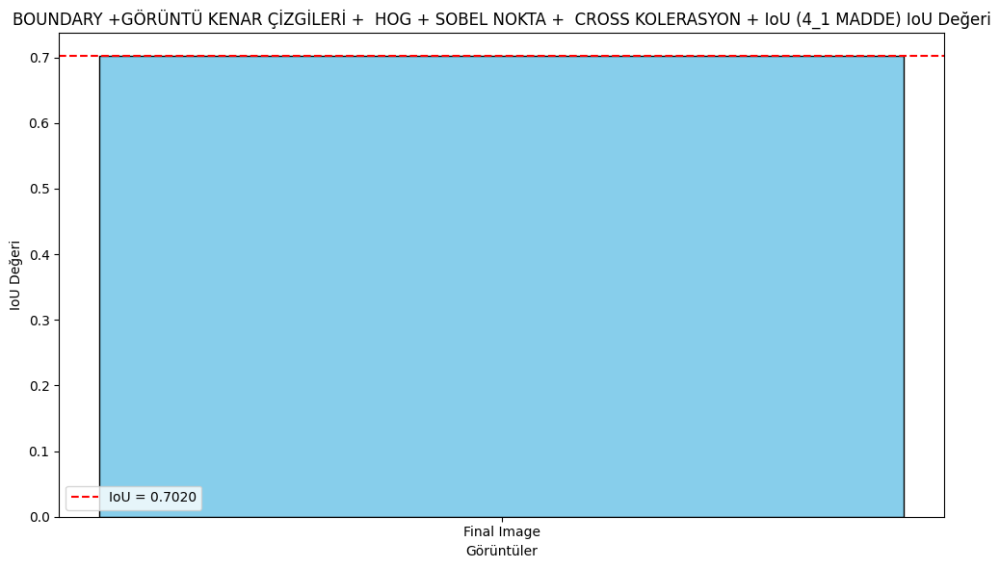

In [45]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(predicted_image, 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# final_image'i kontrol etme
if final_image is None:
    print("Final görüntüsü yüklenemedi!")
else:
    # Eğer final_image zaten gri tonlamalıysa, doğrudan eşikleme yapabilirsiniz
    _, final_binary = cv2.threshold(final_image, 127, 255, cv2.THRESH_BINARY)

# Etiket görüntüsünü yükleme ve kontrol etme
label_image = cv2.imread(r"C:\Users\yakup\OneDrive\Desktop\Labels\label (9).png", cv2.IMREAD_GRAYSCALE)  # Etiket görüntüsünün yolu buraya girilmeli
if label_image is None:
    print("Etiket görüntüsü yüklenemedi!")
else:
    # Etiket görüntüsünü ikili hale getirme
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)


# IoU hesaplama
if final_image is not None and label_image is not None:
    iou = calculate_iou(final_binary, label_binary)
    print(f"Final Image IoU: {iou:.4f}")

    # IoU Grafik Çıktısı
    plt.figure(figsize=(10, 6))
    plt.bar(["Final Image"], [iou], color='skyblue', edgecolor='black')
    plt.axhline(iou, color='red', linestyle='--', label=f"IoU = {iou:.4f}")
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('BOUNDARY +GÖRÜNTÜ KENAR ÇİZGİLERİ +  HOG + SOBEL NOKTA +  CROSS KOLERASYON + IoU (4_1 MADDE) IoU Değeri')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [1]:
############################################################################################################################################

In [31]:
# (4_2 MADDE) GÖRÜNTÜ KENAR ÇİZGİLERİ + BOUNDARY + TEK HOG + SOBEL NOKTA +  CROSS KOLERASYON + IoU

#HER GÖRÜNTÜDEN BOUNDARY İLE ALDIĞIMIZ KENAR NOKTALARI YARDIMIYLA BULDUĞUMUZ 15 PİKSELLİK ÇİZGİLERDEN ALDIĞIMIZ PACHLERİ HOG İLE KODLADIK
#KODLANAN BU HOG KODLARI İLE TEST GÖRSELİNİN HOG KODLARINI CROSS KOLERASYON YARDIMI İLE KARŞILAŞTIRDIK EŞLEŞEN NOKTALARI İŞARETLEDİK
#SON OLARAK MORFOLOJİK OPERASYONLARDAN GEÇİRİP IoU HESAPLADIK
#BU KODUN TEST AŞAMASINDA CANNY YERİNE SOBELLE KENAR NOKTA TESPİTİ YAPTIK DAHA BAŞARILI OLDUĞUNU GÖRDÜK.

In [32]:
#MODELLEME AŞAMASI

In [33]:
#KÜTÜPHANELERİ İMPORT EDİYORUZ

In [34]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
import importlib
import utils
importlib.reload(utils)
from utils import *

In [35]:
#EĞİTİM GÖRSELİ VE LABELLERİ ÖN İŞLEMDEN GEÇİRİLEREK GÖRSELLEŞTİRİLİYOR

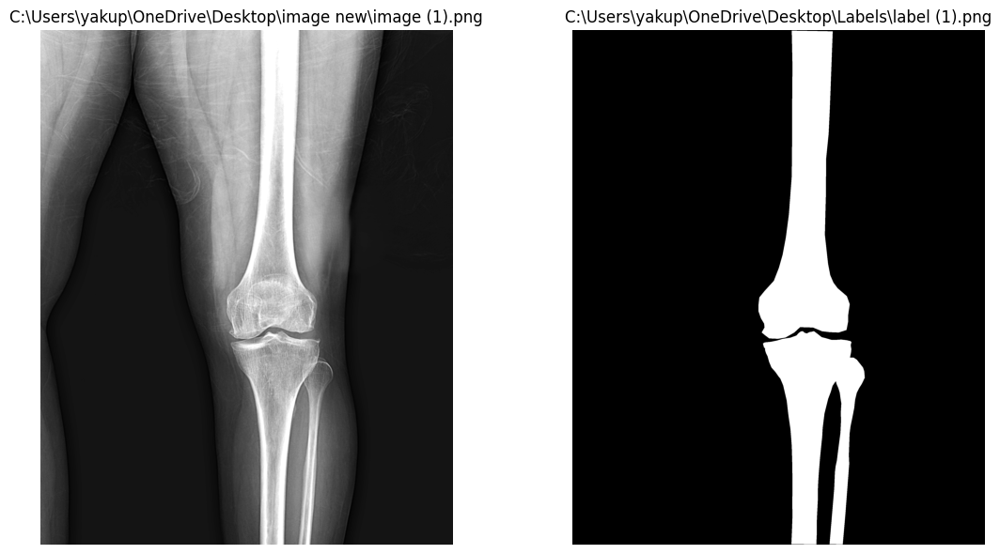

In [36]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
img, label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (1).png",
    draw=True
)


In [37]:
#YAZDIRMA KODLARI

In [38]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()  

In [39]:
#LABEL VE BOUNDARY İLE KENAR NOKTALARINDAN 15 PİKSELLİK ÇİZGİLER ELDE ETTİK (15 PİKSELLİK ÇİZGİLER BOYUNCA PACHLER ALDIK)

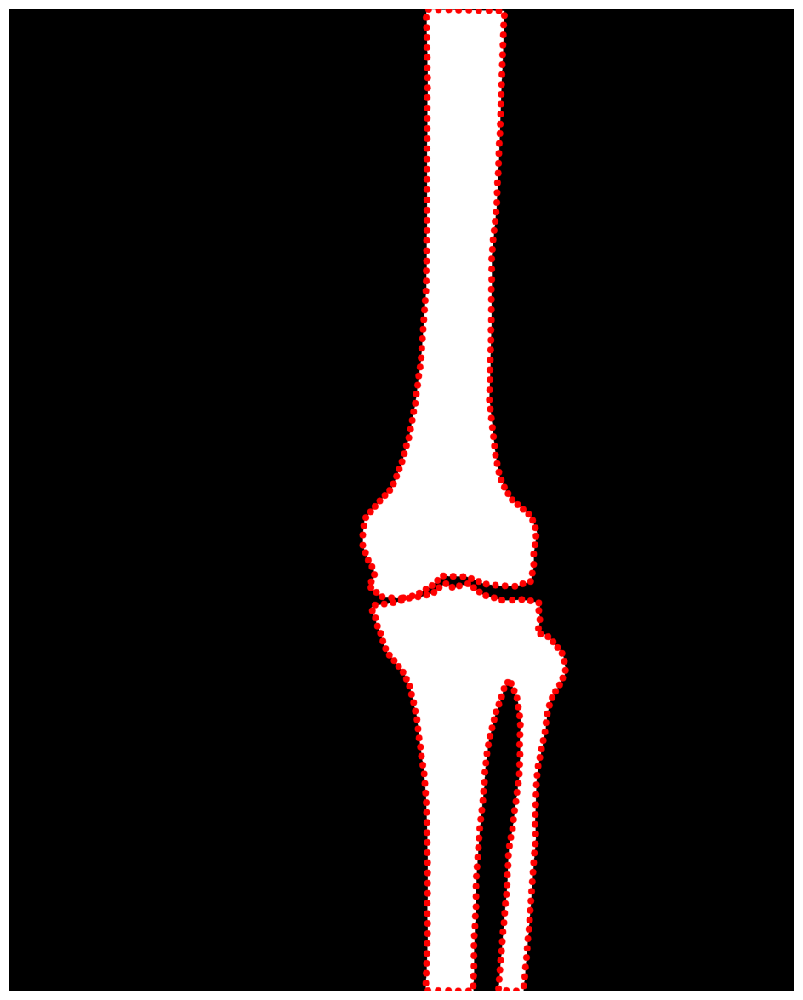

C:\Users\yakup\AppData\Local\Temp\ipykernel_3828\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


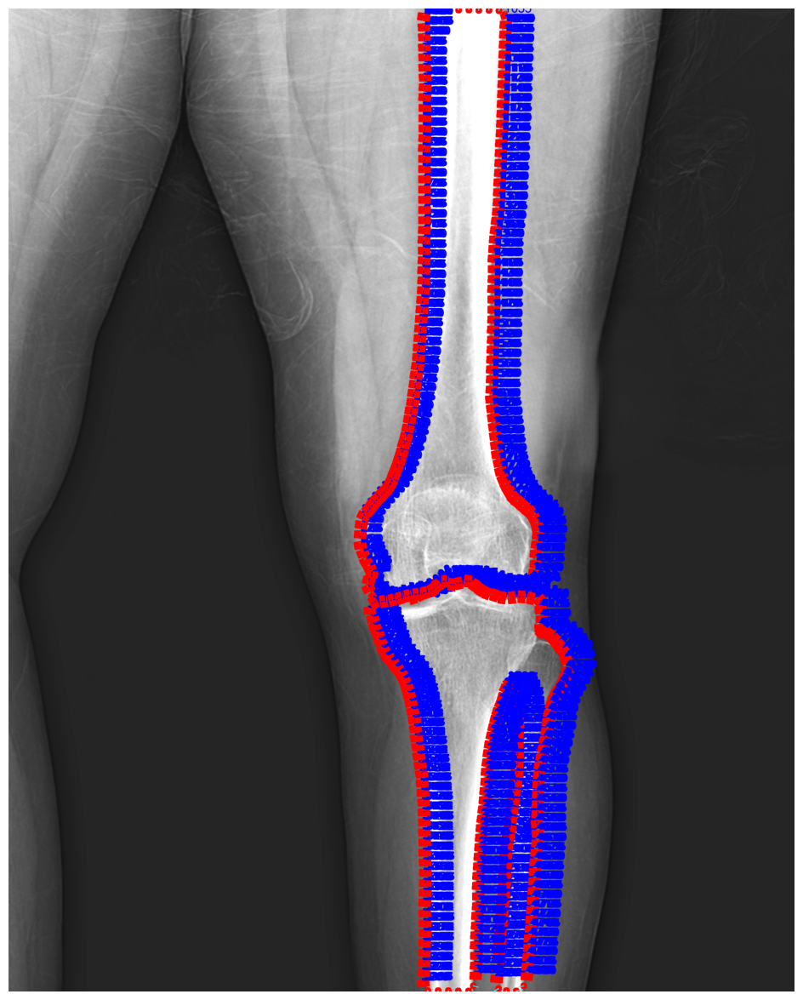

In [40]:
def GetLabelEdgePoints(img, sparsity_factor=1, circle_radius = 10, draw=False):
    contours = measure.find_contours(img, level=0.5)
    # Tüm sınır piksellerini birleştir
    boundary_points = np.vstack(contours)
    
    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        boundary_points = boundary_points[::sparsity_factor]
        
    if draw:
        Drawing(img, EdgePoints=boundary_points, circle_radius=circle_radius)

    return boundary_points.astype(int)

# Kenar Gorsellerini Kodla
img_EdgePoints = GetLabelEdgePoints(label, sparsity_factor=30, circle_radius=10, draw=True)   # EdgePoints --> [p,2] --> (y,x)

def GetLinePatchs(img, EdgePoints, LineLength=15, PatchSize=11, draw=True):
    LinePatchs = []
    LinePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Kenar noktasının koordinatları
        y, x = EdgePoints[i]

        # Çizginin yönü: Beyaz alana doğru
        # Önceki ve sonraki kenar noktasını alıp yönü hesapla
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)  # Çizginin yönünü hesapla

        # Çizginin başından 15 piksel uzaklıkta bir hedef nokta
        line_end_x = x + LineLength * math.cos(angle)
        line_end_y = y + LineLength * math.sin(angle)
        
        # Çizgiyi oluştur
        line_points = []
        for t in range(LineLength):
            line_x = int(x + t * math.cos(angle))
            line_y = int(y + t * math.sin(angle))
            if 0 <= line_x < img.shape[1] and 0 <= line_y < img.shape[0]:
                line_points.append((line_y, line_x))
        
        # Çizgi üzerinde her bir noktadan patch al
        for point in line_points:
            line_y, line_x = point

            # Patch al
            y_start, y_end = line_y - PatchSize, line_y + PatchSize + 1
            x_start, x_end = line_x - PatchSize, line_x + PatchSize + 1

            if y_start < 0 or y_end > img.shape[0] or x_start < 0 or x_end > img.shape[1]:
                continue  # Patch sınırların dışında, atla

            LinePatch = img[line_y - PatchSize:line_y + PatchSize + 1, line_x - PatchSize:line_x + PatchSize + 1]
            LinePatchs.append(LinePatch)
            LinePatchsInfo.append([line_x, line_y, PatchSize, np.degrees(angle)])
    
    if draw:
        # Çizgileri görselleştir
        EdgeLines = []
        for i in range(len(EdgePoints)):
            y, x = EdgePoints[i]
            prev_idx = (i - 1) % len(EdgePoints)
            next_idx = (i + 1) % len(EdgePoints)
            y1, x1 = EdgePoints[prev_idx]
            y2, x2 = EdgePoints[next_idx]
            dx = x2 - x1
            dy = y2 - y1
            if dx == 0 and dy == 0:
                continue  
            angle = math.atan2(-dx, dy)  # Çizginin yönünü hesapla

            # Çizginin başından 15 piksel uzaklıkta bir hedef nokta
            line_end_x = x + LineLength * math.cos(angle)
            line_end_y = y + LineLength * math.sin(angle)
            
            start_point = (x, y)
            stop_point = (int(line_end_x), int(line_end_y))
            EdgeLines.append({"StartPointYX": (y, x), "StopPointYX": (int(line_end_y), int(line_end_x))})
        
        # Görselleştirme
        Drawing(img, EdgePoints=EdgePoints, EdgeLines=EdgeLines, EdgePatchs=LinePatchsInfo)

    return LinePatchs, LinePatchsInfo

# Kenar noktalarından beyaz alana doğru çizgiler çiz ve patch'ler al
img_LinePatchs, img_LinePatchsInfo = GetLinePatchs(img, img_EdgePoints, LineLength=15, PatchSize=20, draw=True)


In [41]:
#PACH LERİ GÖRSELLEŞTİRDİK (15 PİKSELLİK ÇİZGİLER BOYUNCA PACHLER ALDIK)

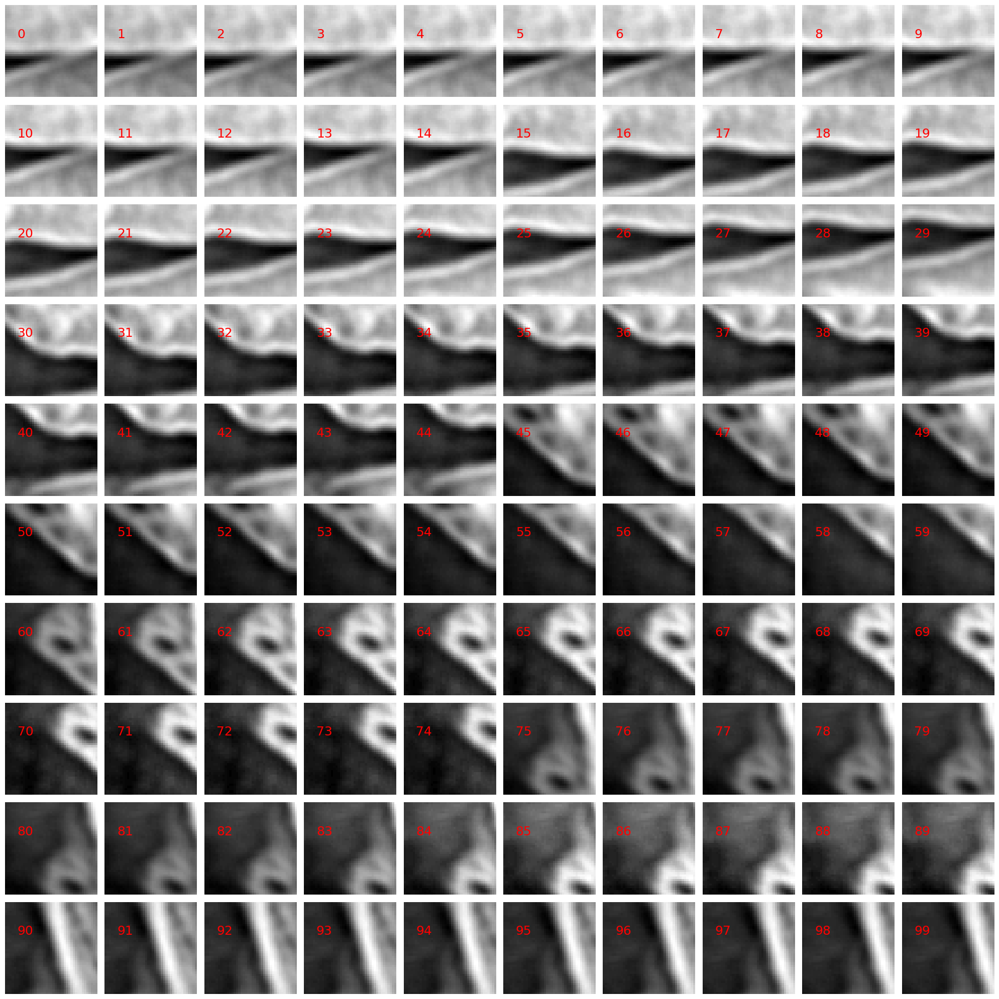

In [42]:
def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    # Toplam patch sayısı
    num_patches = min(len(EdgePatchs), max_patches)  # En fazla max_patches kadar göster
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()


# img_LinePatchs gorsellerini tek figurede gör (ilk 100 patch)
DisplayPatches(img_LinePatchs, max_patches=100)


In [43]:
#TÜM PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK Toplam 4831 patch TEK BİR HOG ile kodlandı.

In [45]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")



# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png", cv2.IMREAD_GRAYSCALE)



# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_2\hog_features_with_coords.npz"
save_hog_features_with_coords(img_LinePatchs, img_LinePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(img_LinePatchs)} patch TEK HOG DOSYASI ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\yakup\OneDrive\Desktop\4_2\hog_features_with_coords.npz
Toplam 4831 patch TEK HOG DOSYASI ile kodlandı.


In [46]:
#TEST AŞAMASI

In [47]:
#TEST GÖRSELİNİ ÖN İŞLEMDEN GEÇİRİP GÖRÜNTÜLEDİK

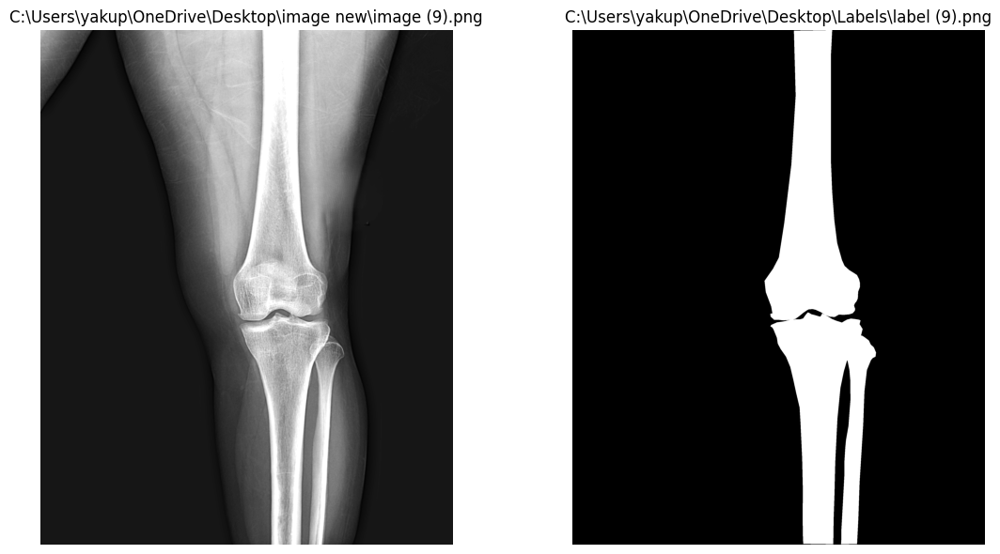

In [48]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
test_img, test_label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png",
    draw=True
)


In [49]:
#SOBEL İLE NOKTA TESPİTİ YAPTIK. Toplam Kenar Noktası Sayısı: 5306

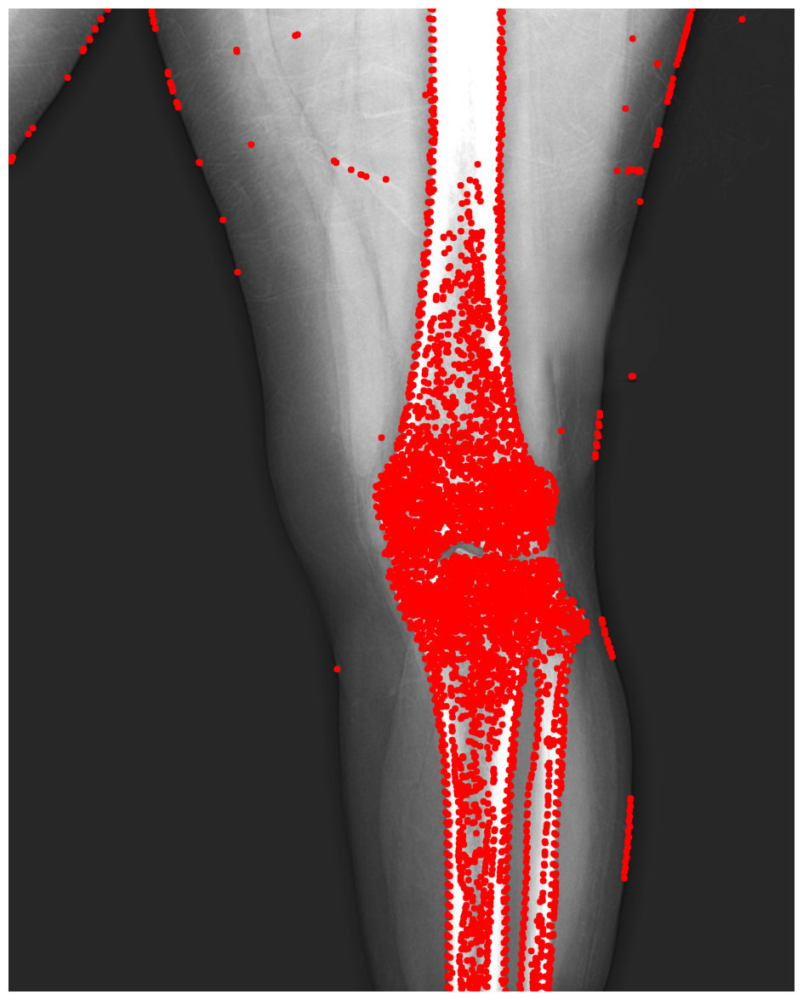

Toplam Kenar Noktası Sayısı: 4854


In [50]:
def GetSobelEdgePoints(img, sparsity_factor=1, draw=False):
    # Sobel filtrelerini uygula (yatay ve dikey gradyanlar)
    grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    
    # Gradyan büyüklüğünü hesapla
    grad_magnitude = cv2.magnitude(grad_x, grad_y)
    
    # Gradyan büyüklüğünü eşik değerine göre ikili görüntüye dönüştür
    _, edges = cv2.threshold(grad_magnitude, 50, 255, cv2.THRESH_BINARY)
    edges = edges.astype(np.uint8)
    
    # Kenar noktalarını bul
    SobelEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in SobelEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    print(f"Toplam Kenar Noktası Sayısı: {len(EdgePoints)}")  # Nokta sayısını yazdır
    return EdgePoints

# Sobel ile kenarları bulma
test_img_EdgePoints = GetSobelEdgePoints(test_img, sparsity_factor=30, draw=True)   # EdgePoints --> [p,2] --> (y,x)


In [51]:
#BU NOKTALARDAN PACHLER ALDIK

C:\Users\yakup\AppData\Local\Temp\ipykernel_3828\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


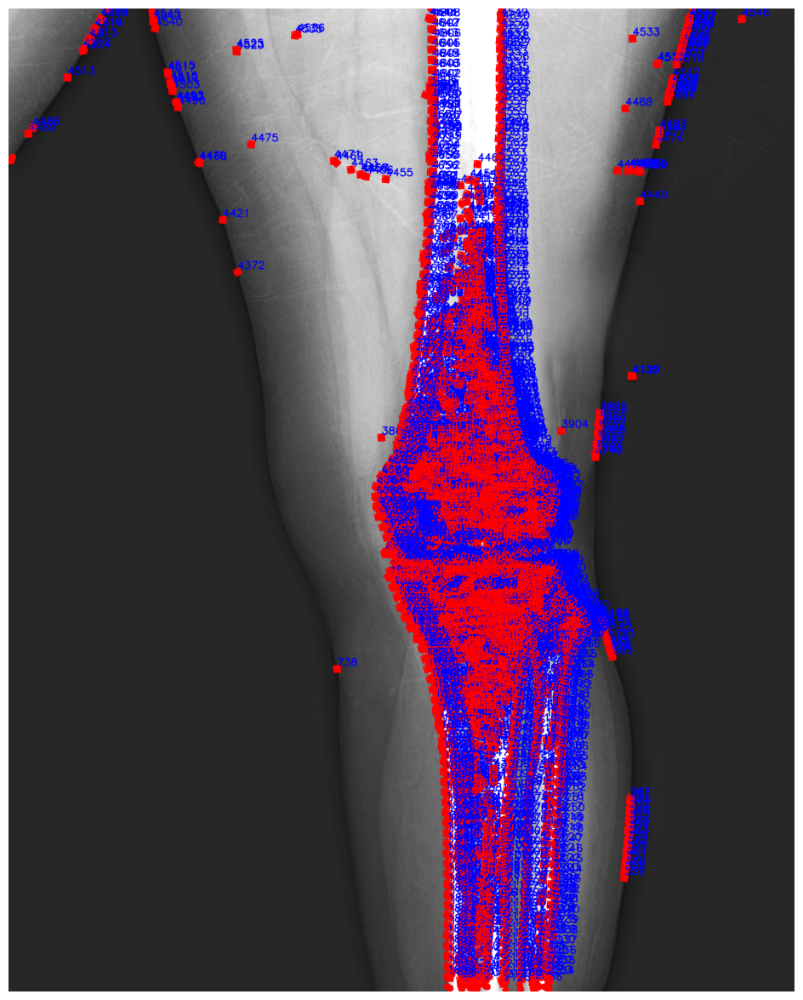

In [20]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo


test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=20, draw=True)

In [54]:
#ALDIĞIMIZ PACHLERİ TEK HOG DOSYASI İLE KODLAYIP KAYIT ETTİK (Toplam 5169 patch HOG ile kodlandı..)

In [55]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")

# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png", cv2.IMREAD_GRAYSCALE)

# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_2\test_image9_hog_features_with_coords.npz"
save_hog_features_with_coords(test_img_EdgePatchs, test_img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(test_img_EdgePatchs)} patch TEK HOG DOSYASI ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\yakup\OneDrive\Desktop\4_2\test_image9_hog_features_with_coords.npz
Toplam 4816 patch TEK HOG DOSYASI ile kodlandı.


In [56]:
#DOSYADA Kİ KAYITLI KLASÖRÜN ANAHTARINI SORGULAYAN KOD

In [57]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_2\test_image9_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['features', 'coords']


In [58]:
#HOG KODLARINI CROSS KOLERASYONLA KARŞILAŞTIRDIK.

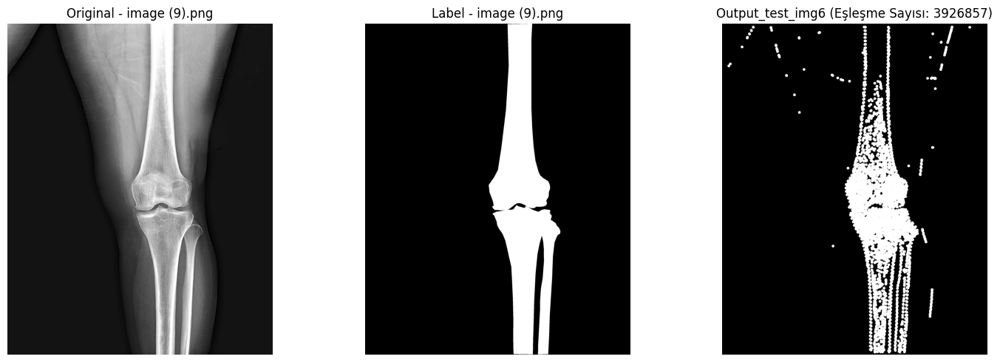

In [59]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_2\hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png"
]

label_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png"
]

hog_files = [
    r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_2\test_image9_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
output_images = []  # Sonuç görsellerini tutmak için bir liste oluştur
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    # Test HOG vektörlerini ve koordinatlarını yükleme
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['features']
    test_coords = hog_data['coords']
    
    # Test görüntüsünü yükleme
    test_image = cv2.imread(test_image_path)
    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma
    
    # Etiket görüntüsünü yükleme
    label_image = cv2.imread(label_image_path)

    # Çapraz korelasyonu hızlı hesaplama
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, stored_idx in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        matching_coords_count += 1
    
    # Görüntü adını dosya yolundan çıkarma
    image_name = test_image_path.split("\\")[-1]
    
    # Sonuç görselini output_images listesine ekleme
    output_images.append(output_img)
    
    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output_test_img{idx + 6} (Eşleşme Sayısı: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Sonuç görsellerini bir değişkende tutma
final_output_image = output_images[-1]  # Son görseli tutan değişken


In [60]:
#FİNAL GÖRÜNTÜSÜNE MORFOLOJİK MÜDAHALELER

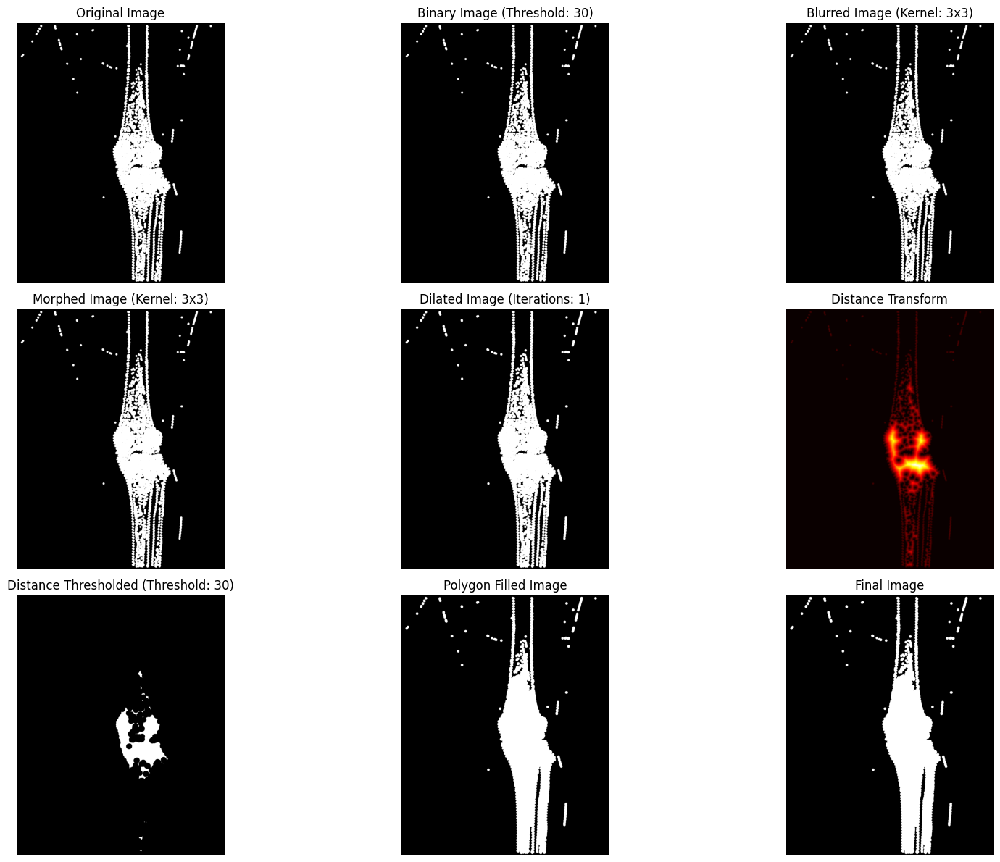

In [90]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme ve gri tonlamaya dönüştürme
if isinstance(final_output_image, np.ndarray):
    if len(final_output_image.shape) == 3:  # Eğer görüntü renkli ise gri tonlamaya dönüştür
        image = cv2.cvtColor(final_output_image, cv2.COLOR_BGR2GRAY)
    else:
        image = final_output_image  # Zaten gri tonlamalı
else:
    image = cv2.imread(final_output_image, cv2.IMREAD_GRAYSCALE)

if image is None:
    raise ValueError("Görüntü yüklenemedi. Lütfen doğru yolu kontrol edin veya geçerli bir NumPy dizisi kullanın.")

# --- Ayarlanabilir Eşik Değerleri ---
threshold_value_initial = 30  # İlk eşik değeri (örneğin kenar tespiti için)
blur_kernel_size = 3          # Bulanıklaştırma için kernel boyutu
morph_kernel_size = 3         # Morfolojik işlemler için kernel boyutu
dilate_iterations = 1        # Dilatasyon iterasyon sayısı
distance_threshold_value = 30 # Distance transform için eşik değeri

# --- Kenarları Tespit Etme ---
_, binary_image = cv2.threshold(image, threshold_value_initial, 255, cv2.THRESH_BINARY)

# --- Bulanıklaştırma ---
blurred_image = cv2.GaussianBlur(binary_image, (blur_kernel_size, blur_kernel_size), 0)

# --- Morfolojik İşlemler: Closing ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (morph_kernel_size, morph_kernel_size))
morphed_image = cv2.morphologyEx(blurred_image, cv2.MORPH_CLOSE, kernel)

# --- Dilatasyon ile Noktaları Birleştirme ---
dilated_image = cv2.dilate(morphed_image, kernel, iterations=dilate_iterations)

# --- Distance Transform ---
distance_transform = cv2.distanceTransform(dilated_image, cv2.DIST_L2, 5)
_, distance_thresholded = cv2.threshold(distance_transform, distance_threshold_value, 255, cv2.THRESH_BINARY)
distance_thresholded = distance_thresholded.astype(np.uint8)

# --- Bağlantılı Bileşen Analizi ---
num_labels, labels_im = cv2.connectedComponents(distance_thresholded)

# --- Konturları Bulma ve Poligon Oluşturma ---
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
polygon_image = np.zeros_like(dilated_image)

for contour in contours:
    # Konturların içini beyaz yap (poligon şekli)
    cv2.fillPoly(polygon_image, [contour], 255)

# Poligon içindeki alanları beyaz yap
final_image = cv2.bitwise_or(dilated_image, polygon_image)

# --- Sonuçları Görselleştirme ---
plt.figure(figsize=(18, 12))

# Orijinal Görüntü
plt.subplot(3, 3, 1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

# İlk Eşiklenmiş Görüntü
plt.subplot(3, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title(f"Binary Image (Threshold: {threshold_value_initial})")
plt.axis('off')

# Bulanıklaştırılmış Görüntü
plt.subplot(3, 3, 3)
plt.imshow(blurred_image, cmap='gray')
plt.title(f"Blurred Image (Kernel: {blur_kernel_size}x{blur_kernel_size})")
plt.axis('off')

# Morfolojik İşlemler Sonrası Görüntü
plt.subplot(3, 3, 4)
plt.imshow(morphed_image, cmap='gray')
plt.title(f"Morphed Image (Kernel: {morph_kernel_size}x{morph_kernel_size})")
plt.axis('off')

# Dilatasyon Sonrası Görüntü
plt.subplot(3, 3, 5)
plt.imshow(dilated_image, cmap='gray')
plt.title(f"Dilated Image (Iterations: {dilate_iterations})")
plt.axis('off')

# Distance Transform Sonrası Görüntü
plt.subplot(3, 3, 6)
plt.imshow(distance_transform, cmap='hot')
plt.title("Distance Transform")
plt.axis('off')

# Distance Threshold Sonrası Görüntü
plt.subplot(3, 3, 7)
plt.imshow(distance_thresholded, cmap='gray')
plt.title(f"Distance Thresholded (Threshold: {distance_threshold_value})")
plt.axis('off')

# Poligon İçinde Beyaz Alanlar
plt.subplot(3, 3, 8)
plt.imshow(polygon_image, cmap='gray')
plt.title("Polygon Filled Image")
plt.axis('off')

# Final Görüntü
plt.subplot(3, 3, 9)
plt.imshow(final_image, cmap='gray')
plt.title("Final Image")
plt.axis('off')

plt.tight_layout()
plt.show()



In [91]:
#IoU HESAPLAMA

Final Image IoU: 0.7137


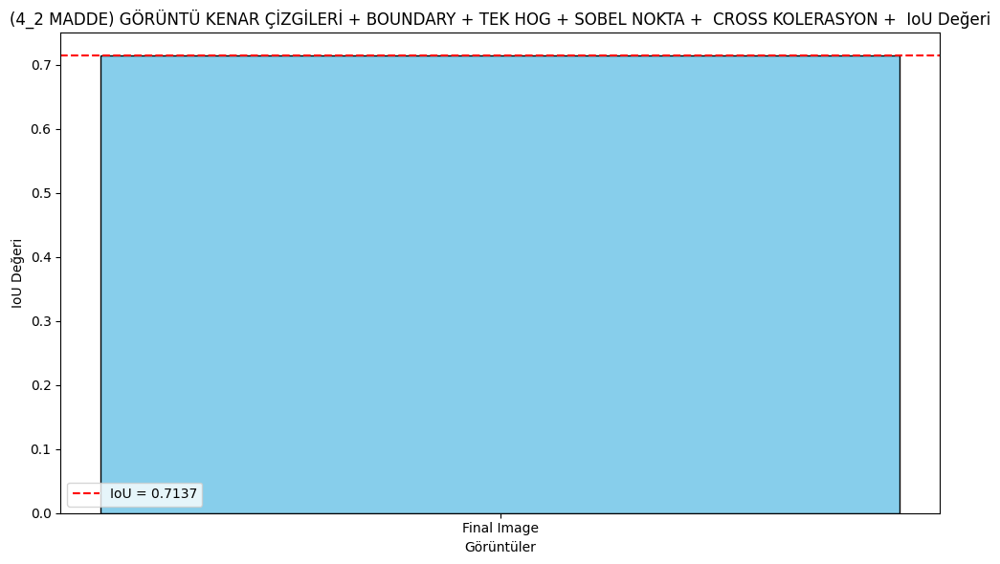

In [92]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(predicted_image, 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# final_image'i kontrol etme
if final_image is None:
    print("Final görüntüsü yüklenemedi!")
else:
    # Eğer final_image zaten gri tonlamalıysa, doğrudan eşikleme yapabilirsiniz
    _, final_binary = cv2.threshold(final_image, 127, 255, cv2.THRESH_BINARY)

# Etiket görüntüsünü yükleme ve kontrol etme
label_image = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png", cv2.IMREAD_GRAYSCALE)  # Etiket görüntüsünün yolu buraya girilmeli
if label_image is None:
    print("Etiket görüntüsü yüklenemedi!")
else:
    # Etiket görüntüsünü ikili hale getirme
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)


# IoU hesaplama
if final_image is not None and label_image is not None:
    iou = calculate_iou(final_binary, label_binary)
    print(f"Final Image IoU: {iou:.4f}")

    # IoU Grafik Çıktısı
    plt.figure(figsize=(10, 6))
    plt.bar(["Final Image"], [iou], color='skyblue', edgecolor='black')
    plt.axhline(iou, color='red', linestyle='--', label=f"IoU = {iou:.4f}")
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('(4_2 MADDE) GÖRÜNTÜ KENAR ÇİZGİLERİ + BOUNDARY + TEK HOG + SOBEL NOKTA +  CROSS KOLERASYON +  IoU Değeri')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [1]:
##############################################################################################################################################

In [1]:
# (4_5 MADDE SOBELLE DENENMESİ)  LABEL KENARI K ÇAPLI + BOUNDARY + HOG + SOBEL HOG + CROSS KOLERASYON + IoU 

#HER GÖRÜNTÜDEN BOUNDARY İLE ALDIĞIMIZ KENAR NOKTALARINDAN ALDIĞIMIZ PACHLERİ HOG İLE KODLADIK
#KODLANAN BU HOG KODLARI İLE TEST GÖRSELİNİN HOG KODLARINI CROSS KOLERASYON YARDIMI İLE KARŞILAŞTIRDIK EŞLEŞEN NOKTALARI İŞARETLEDİK
#SON OLARAK MORFOLOJİK OPERASYONLARDAN GEÇİRİP IoU HESAPLADIK

In [2]:
#MODELLEME AŞAMASI

In [3]:
#KÜTÜPHANELERİ İMPORT EDİYORUZ

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import math
import numpy as np
from kymatio import Scattering2D
from skimage import measure
import importlib
import utils
importlib.reload(utils)
from utils import *

In [5]:
#EĞİTİM GÖRSELİ VE LABELLERİ ÖN İŞLEMDEN GEÇİRİLEREK GÖRSELLEŞTİRİLİYOR

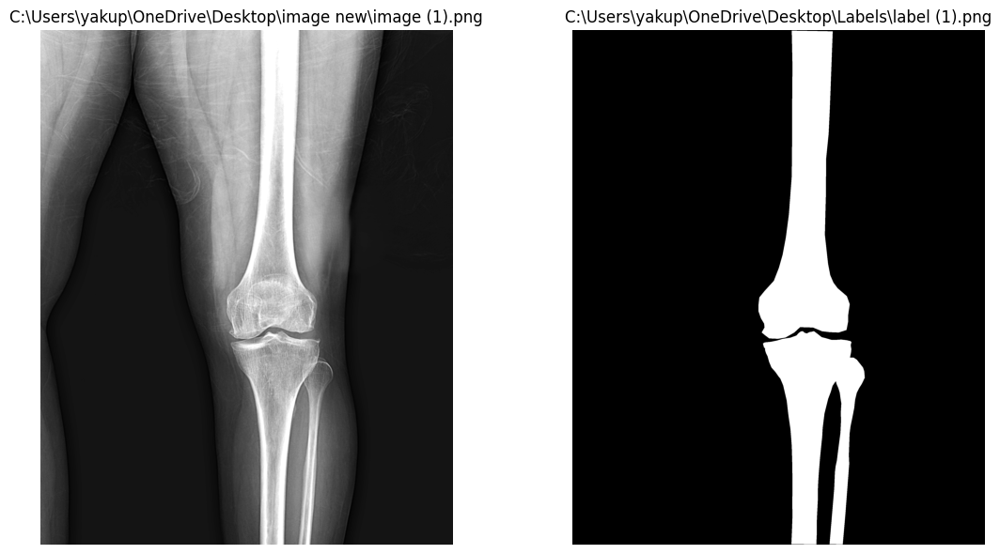

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
img, label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (1).png",
    draw=True
)


In [7]:
#YAZDIRMA KODLARI

In [8]:
def Drawing(img, EdgePoints=None, EdgeLines=None, EdgePatchs=None, title=None, circle_radius = 10):
    output_img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)    
       
    if EdgePoints is not None:         
        for point in EdgePoints:
            x, y = int(point[1]), int(point[0])  # x ve y koordinatları ters çevrilir
            cv2.circle(output_img, (x, y), circle_radius, (0, 0, 255), -1)  # Kırmızı daire   

    if EdgeLines is not None: 
        for Line in EdgeLines:
            start_point = Line["StartPointYX"]
            stop_point = Line["StopPointYX"]
            cv2.line(output_img, start_point[::-1], stop_point[::-1], color = (255, 255, 0) , thickness = 2)                                

    if EdgePatchs is not None: 
        # Img uzerine Patch ciz
        font = cv2.FONT_HERSHEY_SIMPLEX
        font_scale = 1
        color = (255, 0, 0)  
        thickness = 2
        for k, (x,y,PatchSize,angle) in enumerate(EdgePatchs):
            rect = cv2.boxPoints(((float(x), float(y)), (PatchSize, PatchSize), angle))
            rect = np.int0(rect)            
            cv2.drawContours(output_img, [rect], 0, (0, 0, 255), 2)  

            # Draw a line indicating the angle
            end_x = int(x + (PatchSize / 2) * np.cos(np.radians(angle)))
            end_y = int(y + (PatchSize / 2) * np.sin(np.radians(angle)))
            cv2.line(output_img, (x, y), (end_x, end_y), (0, 0, 255), 2)  
            cv2.putText(output_img, str(k), (x, y - 10), font, font_scale, color, thickness, cv2.LINE_AA)    

    # Görüntü boyutlarına göre figsize hesaplama
    height, width = img.shape[:2]
    aspect_ratio = width / height
    figsize = (15 * aspect_ratio, 15)  # Oranı koruyarak uygun bir ölçekleme

    plt.figure(figsize=figsize)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    if title is not None:
        plt.title(title, fontsize=30)
    plt.axis('off')
    plt.show()  

In [9]:
#k ÇAPLI DAİRESEL ALAN KADAR KENAR NOKTALARINı ALDIK

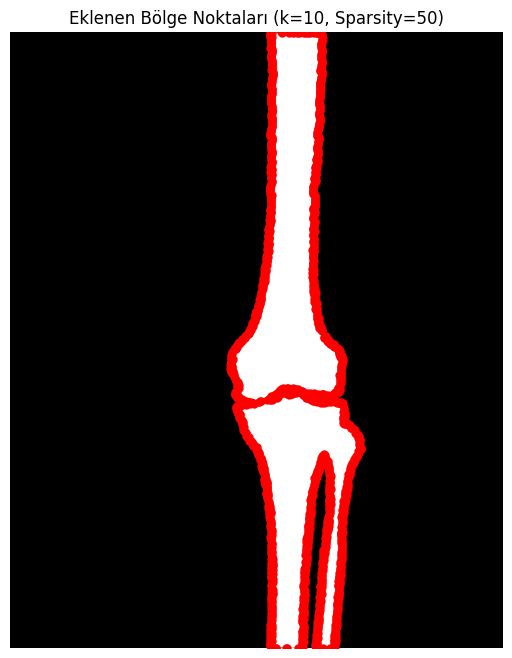

Bulunan Eklenen Noktaların Sayısı: 1774


In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def GetExpandedRegionPoints(label, k=10, sparsity_factor=1, draw=False):
    """
    Genişletilmiş label'den orijinal label'i çıkararak eklenen bölgelerin noktalarını döndürür.

    Args:
        label (numpy.ndarray): İkili (binary) label görüntüsü.
        k (int): Yapısal elementin yarıçapı.
        sparsity_factor (int): Seyrekleştirme faktörü.
        draw (bool): Noktaları çizmek için True.

    Returns:
        numpy.ndarray: Seyrekleştirilmiş nokta koordinatları (y, x).
    """
    # Dairesel yapısal element oluştur
    struct_elem = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (2 * k + 1, 2 * k + 1))

    # Label genişletme (dilate)
    dilated_label = cv2.dilate(label, struct_elem)

    # Genişletilmiş label'den orijinal label'i çıkar
    expanded_region = cv2.subtract(dilated_label, label)

    # Eklenen bölgenin tüm piksellerini al
    points = np.column_stack(np.where(expanded_region > 0))  # Tüm beyaz piksellerin koordinatları

    # Sparsity factor ile seyrekleştirme
    if sparsity_factor > 1:
        points = points[::sparsity_factor]

    # Çizim yapılacaksa
    if draw:
        plt.figure(figsize=(8, 8))
        plt.imshow(label, cmap='gray')
        for point in points:
            y, x = point
            plt.plot(x, y, 'ro', markersize=5)
        plt.title(f"Eklenen Bölge Noktaları (k={k}, Sparsity={sparsity_factor})")
        plt.axis('off')
        plt.show()

    return points

# Kullanım
# img ve label, GetImageLabel fonksiyonu ile alındıktan sonra aşağıdaki kod çalıştırılabilir
expanded_points = GetExpandedRegionPoints(label, k=10, sparsity_factor=50, draw=True)

# Bulunan noktaların sayısını yazdır
print(f"Bulunan Eklenen Noktaların Sayısı: {len(expanded_points)}")


In [11]:
#k ÇAPLI DAİRESEL ALAN KADAR KENAR NOKTALARINDAN PACHLER ALDIK

C:\Users\yakup\AppData\Local\Temp\ipykernel_1240\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


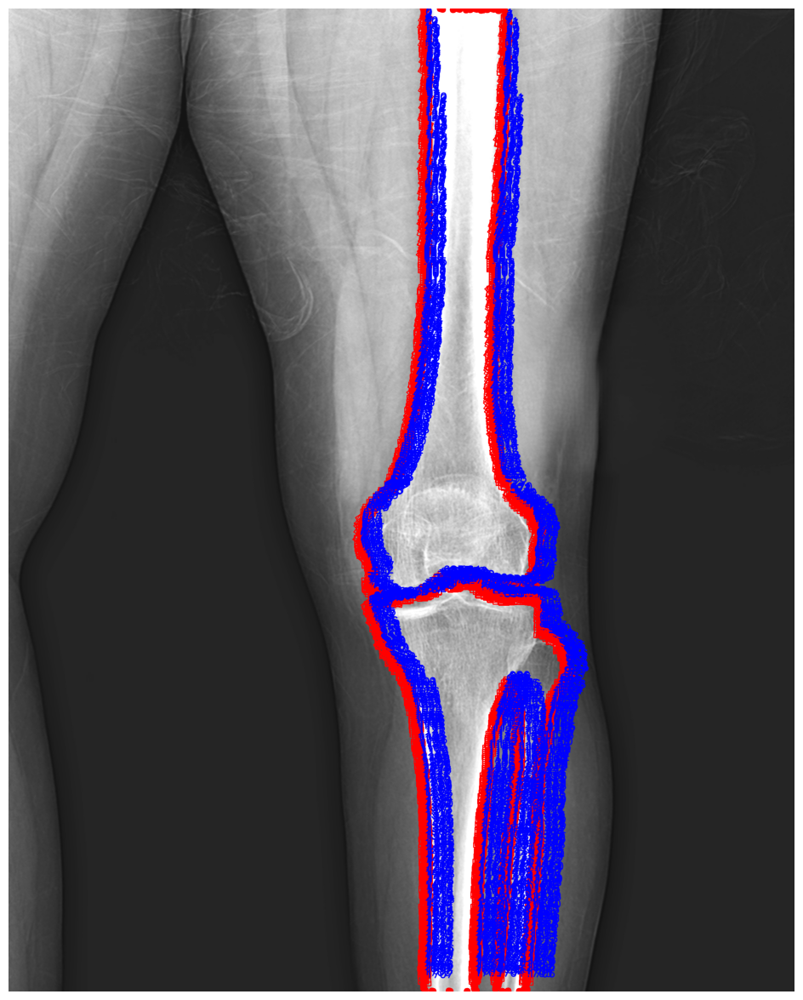

Toplam alınan patch sayısı: 1708


In [12]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x, y, PatchSize, np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs=EdgePatchsInfo)        
        
    total_patches = len(EdgePatchs)  # Toplam patch sayısını hesapla
    return EdgePatchs, EdgePatchsInfo, total_patches

# expanded_points --> img_EdgePatchs 
img_EdgePatchs, img_EdgePatchsInfo, total_patches = GetEdgePatchs(img, expanded_points, PatchSize=30, draw=True)  # M = 2*PatchSize + 1,  MxM = 101x101
print(f"Toplam alınan patch sayısı: {total_patches}")


In [13]:
#PACH LERİ GÖRSELLEŞTİRDİK (sadece ilk 100 pach görselleştirdik)

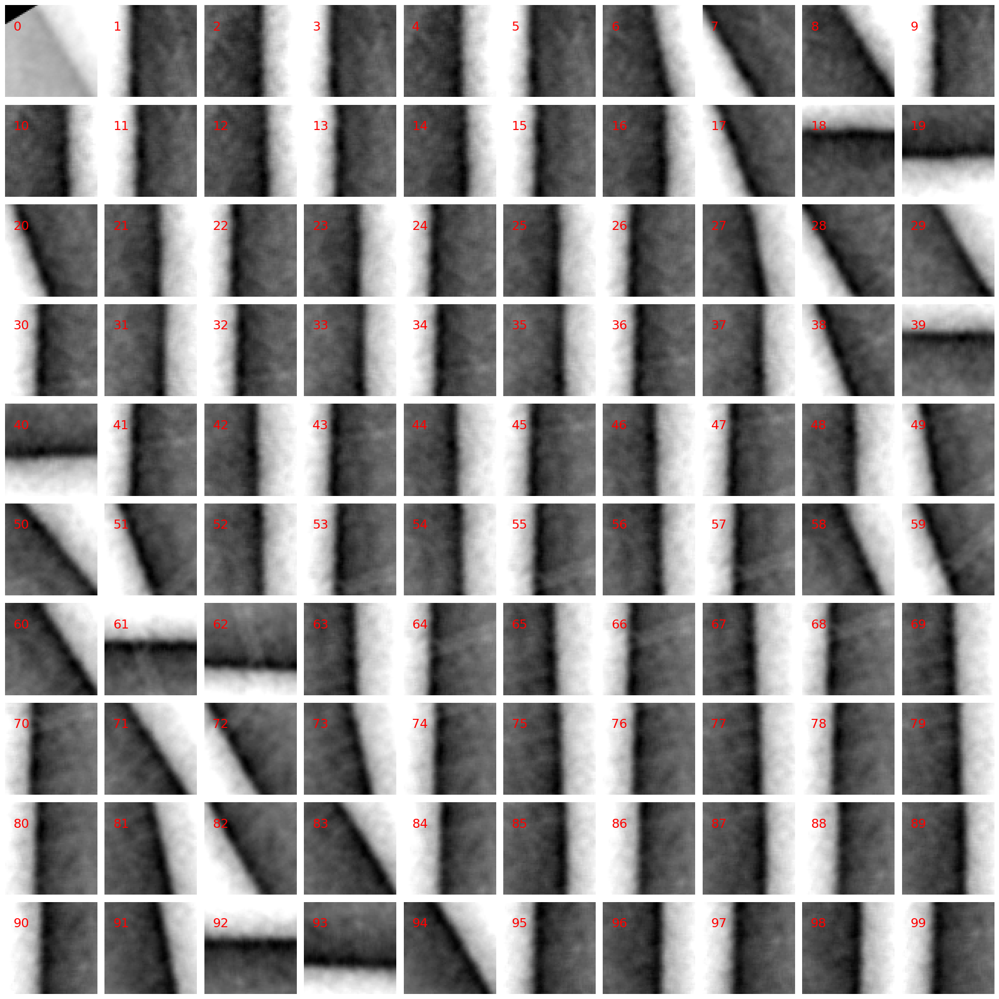

In [14]:
def DisplayPatches(EdgePatchs, max_cols=10, max_patches=100):
    # Toplam patch sayısı
    num_patches = min(len(EdgePatchs), max_patches)  # En fazla max_patches kadar göster
    
    # Sütun sayısı (max_cols ile sınırlı)
    cols = min(max_cols, num_patches)
    
    # Satır sayısını hesapla
    rows = math.ceil(num_patches / cols)
    
    # Şekil oluşturma
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)  # Tek boyutlu diziye dönüştür
    
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(EdgePatchs[i], cmap='gray')
            ax.text(5, 10, str(i), color='red', fontsize=18, ha='left', va='top')
            ax.axis('off')
        else:
            ax.axis('off')  # Fazla eksenleri kapat
    
    plt.tight_layout()
    plt.show()


# img_EdgePatchs gorsellerini tek figurede gör (ilk 100 patch)
DisplayPatches(img_EdgePatchs, max_patches=100)


In [15]:
#TÜM PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK. Toplam 1708 patch HOG ile kodlandı.

In [16]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")



# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (1).png", cv2.IMREAD_GRAYSCALE)



# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_5\hog_features_with_coords.npz"
save_hog_features_with_coords(img_EdgePatchs, img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\yakup\OneDrive\Desktop\4_5\hog_features_with_coords.npz
Toplam 1708 patch HOG ile kodlandı.


In [17]:
#TEST AŞAMASI

In [18]:
#TEST GÖRSELİNİ ÖN İŞLEMDEN GEÇİRİP GÖRÜNTÜLEDİK 
#BURDA DİKEY KEMİKLERDE DAHA ÇOK KENAR NOKTASI ÇIKARACAĞIMIZ EŞLEŞMENİN DAHA ÇOK OLACAĞINI DÜŞÜNDÜĞÜMÜZ İÇİN BU TEST GÖRSELİNİ SEÇTİK

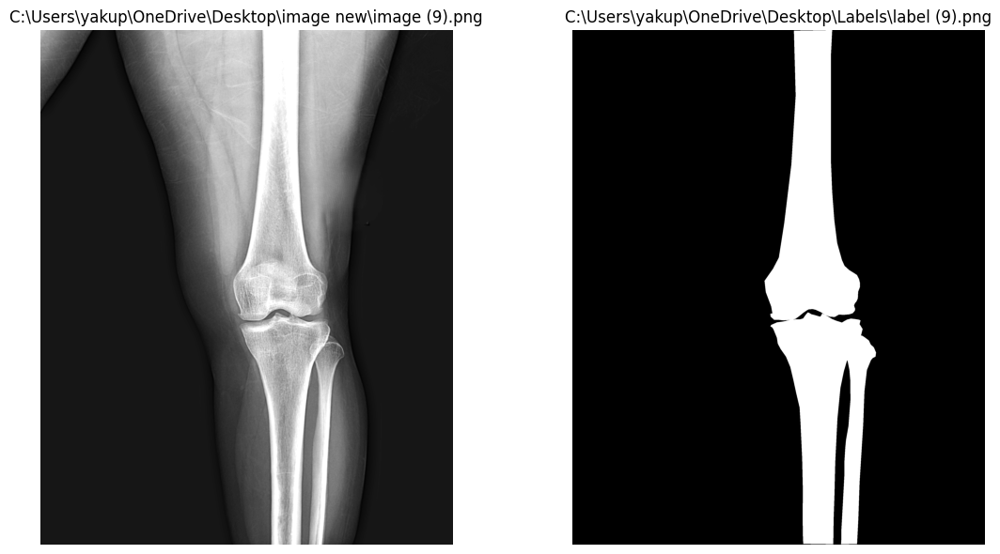

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def ConvertAndNormalize(img, apply_preprocessing=True):
    # Eğer görüntü renkli ise gri tonlamaya çevir
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # I1 Norm Normalizasyonu
    normalized_image = img / 255.0  # Piksel değerlerini [0, 1] aralığına getir
    normalized_image = (normalized_image * 255).astype(np.uint8)  # [0, 255] aralığına geri çevir
    
    # Ön işleme işlemleri
    if apply_preprocessing:
        # Ortalama (Mean) Filtreleme
        def mean_filter(image, kernel_size=5):
            return cv2.blur(image, (kernel_size, kernel_size))  # Ortalama filtre uygula

        mean_filtered = mean_filter(normalized_image, kernel_size=5)

        # Parlaklık Artırma
        brightness_increase = 20  # Parlaklık artırma miktarı
        brightened_image = cv2.add(mean_filtered, np.full_like(mean_filtered, brightness_increase))

        # Keskinleştirme (Unsharp Masking)
        def sharpen_image(image):
            blurred = cv2.GaussianBlur(image, (5, 5), 1.5)  # Gaussian blur uygula
            sharpened = cv2.addWeighted(image, 1.5, blurred, -0.5, 0)  # Keskinleştirme işlemi
            return sharpened

        sharpened_image = sharpen_image(brightened_image)
    
    # Normalize edilmiş görüntü döndürülür
    return sharpened_image

def GetImageLabel(imgStr, labelStr, draw=False):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE); img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)        
    if draw:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.imshow(img, cmap='gray')
        plt.title(imgStr)
        plt.axis('off')
        
        plt.subplot(1, 2, 2)
        plt.imshow(label, cmap='gray')
        plt.title(labelStr)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()  
    return img, label

# img ve label gorselleri al
test_img, test_label = GetImageLabel(
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png",
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png",
    draw=True
)


In [20]:
#SOBEL İLE KENAR NOKTASI ÇIKARMA

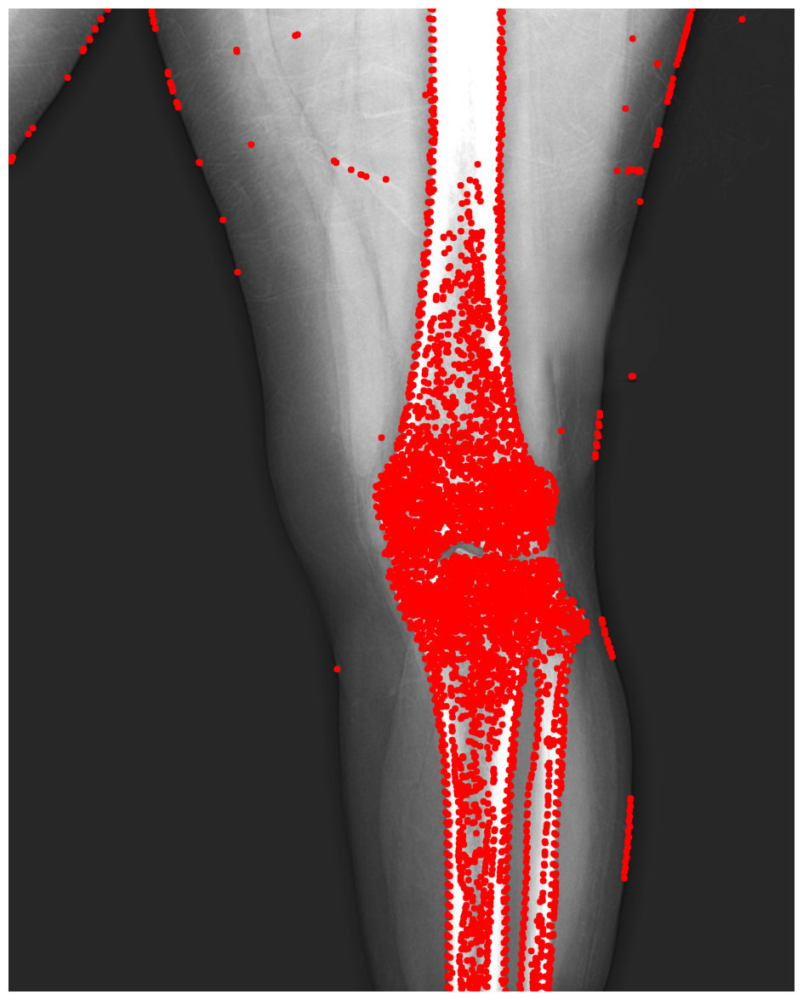

Bulunan toplam kenar noktası sayısı: 4854


In [21]:
def GetSobelEdgePoints(img, sparsity_factor=1, draw=False):
    # Sobel filtrelerini uygula (yatay ve dikey gradyanlar)
    grad_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    
    # Gradyan büyüklüğünü hesapla
    grad_magnitude = cv2.magnitude(grad_x, grad_y)
    
    # Gradyan büyüklüğünü eşik değerine göre ikili görüntüye dönüştür
    _, edges = cv2.threshold(grad_magnitude, 50, 255, cv2.THRESH_BINARY)
    edges = edges.astype(np.uint8)
    
    # Kenar noktalarını bul
    SobelEdgePoints, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    EdgePoints = []
    for ObjPoints in SobelEdgePoints:
        EdgePoints = EdgePoints + [(point[0][1], point[0][0]) for i, point in enumerate(ObjPoints) if i % sparsity_factor == 0]

    if draw:
        Drawing(img, EdgePoints=EdgePoints)

    print(f"Bulunan toplam kenar noktası sayısı: {len(EdgePoints)}")
    return EdgePoints

# Sobel ile kenarları bulma
test_img_EdgePoints = GetSobelEdgePoints(test_img, sparsity_factor=30, draw=True)   # EdgePoints --> [p,2] --> (y,x)


In [22]:
#BU NOKTALARDAN PACHLER ALDIK

C:\Users\yakup\AppData\Local\Temp\ipykernel_1240\2609303510.py:23: DeprecationWarning: `np.int0` is a deprecated alias for `np.intp`.  (Deprecated NumPy 1.24)
  rect = np.int0(rect)


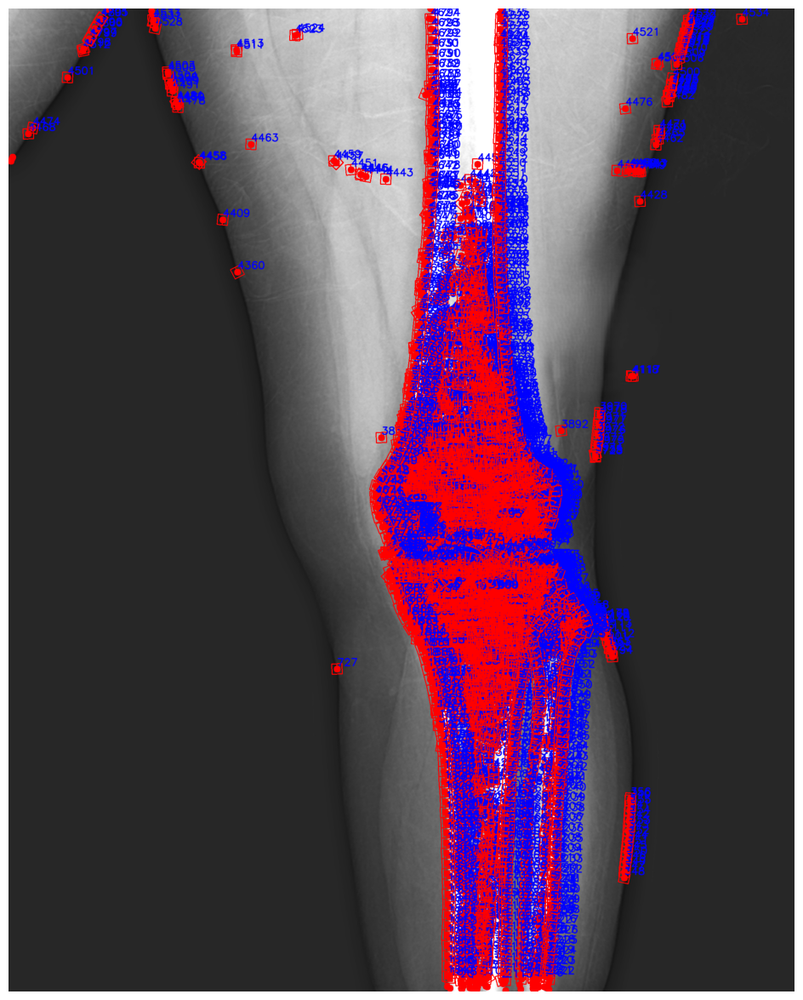

In [23]:
def GetEdgePatchs(img, EdgePoints, PatchSize=11, draw=True):
    EdgePatchs = []
    EdgePatchsInfo = []
    for i in range(len(EdgePoints)):
        # Çizginin başlangıç noktası
        y, x = EdgePoints[i]

        # Çizginin yönü
        prev_idx = (i - 1) % len(EdgePoints)
        next_idx = (i + 1) % len(EdgePoints)
        y1, x1 = EdgePoints[prev_idx]
        y2, x2 = EdgePoints[next_idx]
        dx = x2 - x1
        dy = y2 - y1
        if dx == 0 and dy == 0:
            continue  
        angle = math.atan2(-dx, dy)

        # Patch al
        center = (float(x), float(y))
        rotation_matrix = cv2.getRotationMatrix2D(center, np.degrees(angle), scale=1.0)
        rows, cols = img.shape
        rotated_image = cv2.warpAffine(img, rotation_matrix, (cols, rows), flags=cv2.INTER_LINEAR, borderMode=cv2.BORDER_CONSTANT, borderValue=0)
        # Patch sınırlarını kontrol et
        y_start, y_end = y - PatchSize, y + PatchSize + 1
        x_start, x_end = x - PatchSize, x + PatchSize + 1

        if y_start < 0 or y_end > rows or x_start < 0 or x_end > cols:
            # Patch görüntü sınırlarının dışında, atla
            continue
                
        EdgePatch = rotated_image[y-PatchSize:y+PatchSize+1, x-PatchSize:x+PatchSize+1]

        EdgePatchs.append(EdgePatch)
        EdgePatchsInfo.append([x,y,PatchSize,np.degrees(angle)])
    
    if draw:
        Drawing(img, EdgePoints=EdgePoints, EdgePatchs = EdgePatchsInfo)        
        
    return EdgePatchs, EdgePatchsInfo


test_img_EdgePatchs, test_img_EdgePatchsInfo = GetEdgePatchs(test_img, test_img_EdgePoints, PatchSize=30, draw=True)

In [26]:
#ALDIĞIMIZ PACHLERİ HOG İLE KODLAYIP KAYIT ETTİK (Toplam 4802 patch HOG ile kodlandı.)

In [25]:
import cv2
import numpy as np
import os
import math

# HOG özelliklerini hesaplayan fonksiyon
def compute_hog_features(image, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Verilen görüntü için HOG özelliklerini hesaplar.
    """
    hog = cv2.HOGDescriptor(
        _winSize=(image.shape[1] // cell_size[1] * cell_size[1], 
                  image.shape[0] // cell_size[0] * cell_size[0]),
        _blockSize=(block_size[1] * cell_size[1], block_size[0] * cell_size[0]),
        _blockStride=(cell_size[1], cell_size[0]),
        _cellSize=(cell_size[1], cell_size[0]),
        _nbins=nbins
    )
    features = hog.compute(image)
    return features.flatten()

# HOG özelliklerini ve koordinatlarını kaydeden fonksiyon
def save_hog_features_with_coords(patches, patch_info, output_path, cell_size=(8, 8), block_size=(2, 2), nbins=9):
    """
    Patch'lerin HOG özelliklerini ve koordinatlarını HDD'ye kaydeder.
    """
    all_features = []
    all_coords = []

    for i, (patch, info) in enumerate(zip(patches, patch_info)):
        features = compute_hog_features(patch, cell_size, block_size, nbins)
        all_features.append(features)
        all_coords.append(info)

    all_features = np.array(all_features)
    all_coords = np.array(all_coords)

    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    np.savez(output_path, features=all_features, coords=all_coords)
    print(f"HOG özellikleri ve koordinatlar kaydedildi: {output_path}")

# Görüntüyü ve kenar noktalarını al (örneğin, img_EdgePoints burada)
img = cv2.imread(r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png", cv2.IMREAD_GRAYSCALE)

# HOG özelliklerini kaydetme
output_file_with_coords = r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_5\test_image9_hog_features_with_coords.npz"
save_hog_features_with_coords(test_img_EdgePatchs, test_img_EdgePatchsInfo, output_file_with_coords)

# Sonuç olarak toplam kaç patch kodlandığını yazdır
print(f"Toplam {len(test_img_EdgePatchs)} patch HOG ile kodlandı.")


HOG özellikleri ve koordinatlar kaydedildi: C:\Users\yakup\OneDrive\Desktop\4_5\test_image9_hog_features_with_coords.npz
Toplam 4802 patch HOG ile kodlandı.


In [27]:
#DOSYADA Kİ KAYITLI KLASÖRÜN ANAHTARINI SORGULAYAN KOD

In [28]:
# Dosyanın içeriğini kontrol etme
hog_data = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_5\test_image9_hog_features_with_coords.npz")
print(hog_data.files)  # Dosyanın içinde hangi anahtarların bulunduğunu gösterir


['features', 'coords']


In [29]:
#HOG KODLARINI CROSS KOLERASYONLA KARŞILAŞTIRDIK.

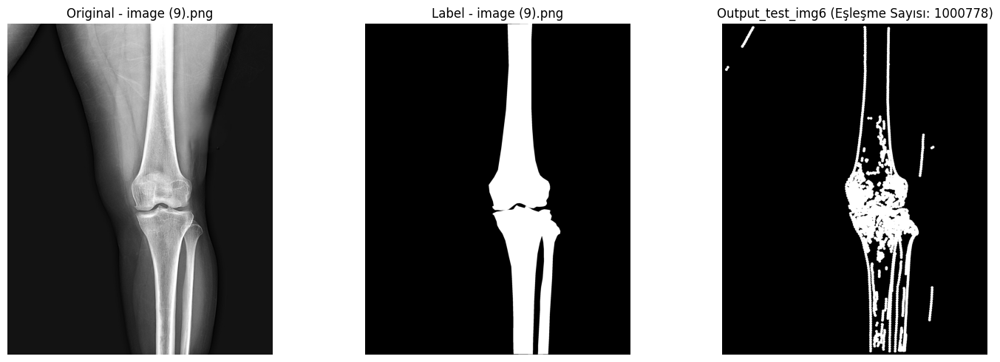

In [30]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Optimize edilmiş çapraz korelasyon fonksiyonu
def compute_cross_correlation_optimized(vectors1, vectors2):
    return 1 - cdist(vectors1, vectors2, metric='correlation')  # Korelasyon mesafesi

# HDD'deki referans HOG vektörlerini yükleme
stored_hog_vectors = np.load(r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_5\hog_features_with_coords.npz")['features']

# İşlenecek test görüntüleri, etiketler ve HOG dosyalarının yolları
test_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\images\image (9).png"
]

label_image_paths = [
    r"C:\Users\wdewe\OneDrive\Desktop\Labels\label (9).png"
]

hog_files = [
    r"C:\Users\wdewe\OneDrive\Belgeler\Dersler\Güncel Dersler\Görüntü İşleme - Biyomedikal Mühendisliği - Bitirme Projesi\Büt\Kodlar\Görüntü İşleme\Kenar Deseni Kodlama (15 Puan)\4_5\test_image9_hog_features_with_coords.npz"
]

# Görüntü işleme ve korelasyon hesaplama
plt.figure(figsize=(15, len(test_image_paths) * 5))
output_images = []  # Sonuç görsellerini tutmak için bir liste oluştur
for idx, (test_image_path, label_image_path, hog_file) in enumerate(zip(test_image_paths, label_image_paths, hog_files)):
    # Test HOG vektörlerini ve koordinatlarını yükleme
    hog_data = np.load(hog_file)
    test_hog_vectors = hog_data['features']
    test_coords = hog_data['coords']
    
    # Test görüntüsünü yükleme
    test_image = cv2.imread(test_image_path)
    output_img = np.zeros_like(test_image)  # Siyah bir görüntü oluşturma
    
    # Etiket görüntüsünü yükleme
    label_image = cv2.imread(label_image_path)

    # Çapraz korelasyonu hızlı hesaplama
    correlations_matrix = compute_cross_correlation_optimized(test_hog_vectors, stored_hog_vectors)
    threshold = 0.30
    high_correlation_indices = np.argwhere(correlations_matrix >= threshold)

    # Yüksek korelasyon eşleşmelerini işleme
    matching_coords_count = 0
    for test_idx, stored_idx in high_correlation_indices:
        coord = test_coords[test_idx]
        x, y = int(coord[0]), int(coord[1])
        cv2.circle(output_img, (x, y), 12, (255, 255, 255), -1)
        matching_coords_count += 1
    
    # Görüntü adını dosya yolundan çıkarma
    image_name = test_image_path.split("\\")[-1]
    
    # Sonuç görselini output_images listesine ekleme
    output_images.append(output_img)
    
    # Orijinal görüntü, etiket ve çıktı görselleştirme
    plt.subplot(len(test_image_paths), 3, idx * 3 + 1)
    plt.imshow(cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Original - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 2)
    plt.imshow(cv2.cvtColor(label_image, cv2.COLOR_BGR2RGB))
    plt.title(f"Label - {image_name}")
    plt.axis('off')
    
    plt.subplot(len(test_image_paths), 3, idx * 3 + 3)
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Output_test_img{idx + 6} (Eşleşme Sayısı: {matching_coords_count})")
    plt.axis('off')

plt.tight_layout()
plt.show()

# Sonuç görsellerini bir değişkende tutma
final_output_image = output_images[-1]  # Son görseli tutan değişken


In [ ]:
#FİNAL GÖRÜNTÜSÜNE MORFOLOJİK MÜDAHALELER

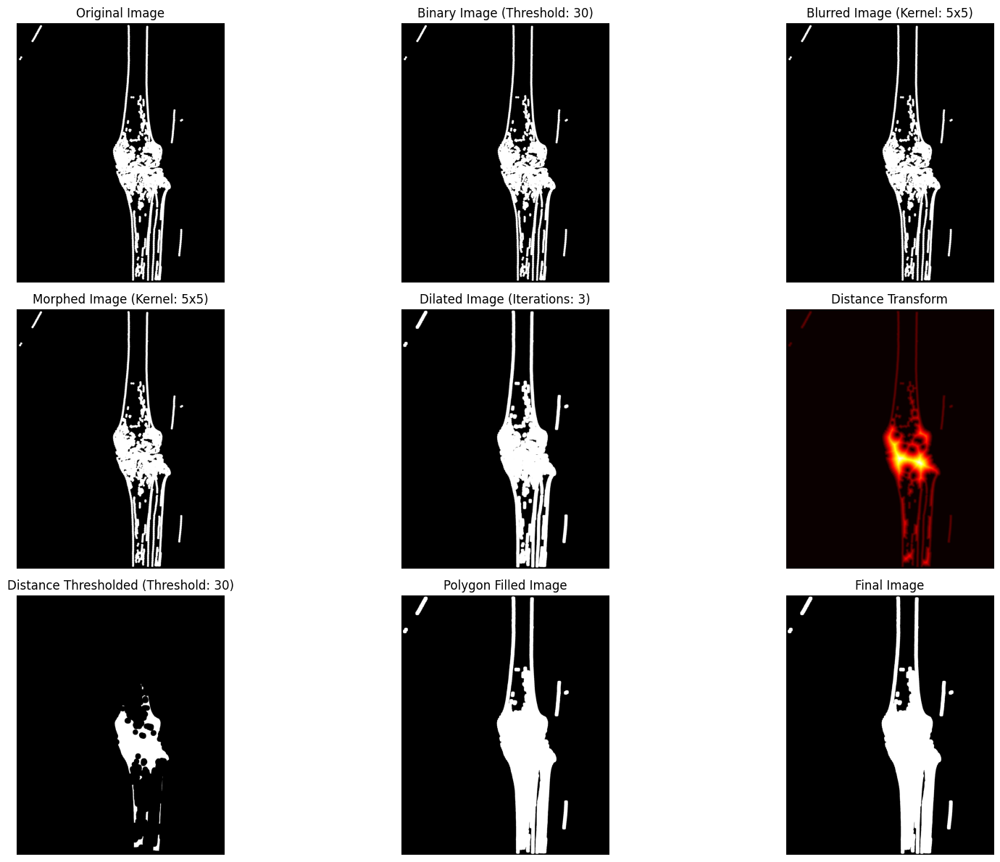

In [44]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Görüntüyü yükleme ve gri tonlamaya dönüştürme
if isinstance(final_output_image, np.ndarray):
    if len(final_output_image.shape) == 3:  # Eğer görüntü renkli ise gri tonlamaya dönüştür
        image = cv2.cvtColor(final_output_image, cv2.COLOR_BGR2GRAY)
    else:
        image = final_output_image  # Zaten gri tonlamalı
else:
    image = cv2.imread(final_output_image, cv2.IMREAD_GRAYSCALE)

if image is None:
    raise ValueError("Görüntü yüklenemedi. Lütfen doğru yolu kontrol edin veya geçerli bir NumPy dizisi kullanın.")

# --- Ayarlanabilir Eşik Değerleri ---
threshold_value_initial = 30  # İlk eşik değeri (örneğin kenar tespiti için)
blur_kernel_size = 5          # Bulanıklaştırma için kernel boyutu
morph_kernel_size = 5         # Morfolojik işlemler için kernel boyutu
dilate_iterations = 3        # Dilatasyon iterasyon sayısı
distance_threshold_value = 30 # Distance transform için eşik değeri

# --- Kenarları Tespit Etme ---
_, binary_image = cv2.threshold(image, threshold_value_initial, 255, cv2.THRESH_BINARY)

# --- Bulanıklaştırma ---
blurred_image = cv2.GaussianBlur(binary_image, (blur_kernel_size, blur_kernel_size), 0)

# --- Morfolojik İşlemler: Closing ---
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (morph_kernel_size, morph_kernel_size))
morphed_image = cv2.morphologyEx(blurred_image, cv2.MORPH_CLOSE, kernel)

# --- Dilatasyon ile Noktaları Birleştirme ---
dilated_image = cv2.dilate(morphed_image, kernel, iterations=dilate_iterations)

# --- Distance Transform ---
distance_transform = cv2.distanceTransform(dilated_image, cv2.DIST_L2, 5)
_, distance_thresholded = cv2.threshold(distance_transform, distance_threshold_value, 255, cv2.THRESH_BINARY)
distance_thresholded = distance_thresholded.astype(np.uint8)

# --- Bağlantılı Bileşen Analizi ---
num_labels, labels_im = cv2.connectedComponents(distance_thresholded)

# --- Konturları Bulma ve Poligon Oluşturma ---
contours, _ = cv2.findContours(dilated_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
polygon_image = np.zeros_like(dilated_image)

for contour in contours:
    # Konturların içini beyaz yap (poligon şekli)
    cv2.fillPoly(polygon_image, [contour], 255)

# Poligon içindeki alanları beyaz yap
final_image = cv2.bitwise_or(dilated_image, polygon_image)

# --- Sonuçları Görselleştirme ---
plt.figure(figsize=(18, 12))

# Orijinal Görüntü
plt.subplot(3, 3, 1)
plt.imshow(image, cmap='gray')
plt.title("Original Image")
plt.axis('off')

# İlk Eşiklenmiş Görüntü
plt.subplot(3, 3, 2)
plt.imshow(binary_image, cmap='gray')
plt.title(f"Binary Image (Threshold: {threshold_value_initial})")
plt.axis('off')

# Bulanıklaştırılmış Görüntü
plt.subplot(3, 3, 3)
plt.imshow(blurred_image, cmap='gray')
plt.title(f"Blurred Image (Kernel: {blur_kernel_size}x{blur_kernel_size})")
plt.axis('off')

# Morfolojik İşlemler Sonrası Görüntü
plt.subplot(3, 3, 4)
plt.imshow(morphed_image, cmap='gray')
plt.title(f"Morphed Image (Kernel: {morph_kernel_size}x{morph_kernel_size})")
plt.axis('off')

# Dilatasyon Sonrası Görüntü
plt.subplot(3, 3, 5)
plt.imshow(dilated_image, cmap='gray')
plt.title(f"Dilated Image (Iterations: {dilate_iterations})")
plt.axis('off')

# Distance Transform Sonrası Görüntü
plt.subplot(3, 3, 6)
plt.imshow(distance_transform, cmap='hot')
plt.title("Distance Transform")
plt.axis('off')

# Distance Threshold Sonrası Görüntü
plt.subplot(3, 3, 7)
plt.imshow(distance_thresholded, cmap='gray')
plt.title(f"Distance Thresholded (Threshold: {distance_threshold_value})")
plt.axis('off')

# Poligon İçinde Beyaz Alanlar
plt.subplot(3, 3, 8)
plt.imshow(polygon_image, cmap='gray')
plt.title("Polygon Filled Image")
plt.axis('off')

# Final Görüntü
plt.subplot(3, 3, 9)
plt.imshow(final_image, cmap='gray')
plt.title("Final Image")
plt.axis('off')

plt.tight_layout()
plt.show()



In [45]:
#IoU HESAPLAMA

Final Image IoU: 0.6302


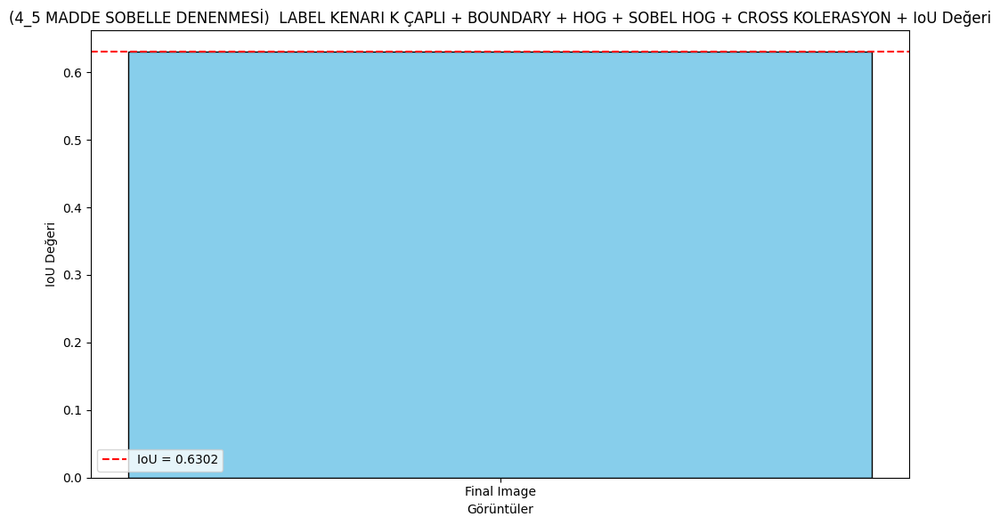

In [46]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# IoU hesaplama fonksiyonu
def calculate_iou(predicted_image, label_image):
    # İkili görüntüye dönüştürme (thresholding)
    _, pred_binary = cv2.threshold(predicted_image, 127, 255, cv2.THRESH_BINARY)
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)
    
    # Kesişim ve birleşim
    intersection = np.logical_and(pred_binary > 0, label_binary > 0).sum()
    union = np.logical_or(pred_binary > 0, label_binary > 0).sum()
    
    # IoU hesaplama
    iou = intersection / union if union != 0 else 0
    return iou

# final_image'i kontrol etme
if final_image is None:
    print("Final görüntüsü yüklenemedi!")
else:
    # Eğer final_image zaten gri tonlamalıysa, doğrudan eşikleme yapabilirsiniz
    _, final_binary = cv2.threshold(final_image, 127, 255, cv2.THRESH_BINARY)

# Etiket görüntüsünü yükleme ve kontrol etme
label_image = cv2.imread(r"C:\Users\yakup\OneDrive\Desktop\Labels\label (9).png", cv2.IMREAD_GRAYSCALE)  # Etiket görüntüsünün yolu buraya girilmeli
if label_image is None:
    print("Etiket görüntüsü yüklenemedi!")
else:
    # Etiket görüntüsünü ikili hale getirme
    _, label_binary = cv2.threshold(label_image, 127, 255, cv2.THRESH_BINARY)


# IoU hesaplama
if final_image is not None and label_image is not None:
    iou = calculate_iou(final_binary, label_binary)
    print(f"Final Image IoU: {iou:.4f}")

    # IoU Grafik Çıktısı
    plt.figure(figsize=(10, 6))
    plt.bar(["Final Image"], [iou], color='skyblue', edgecolor='black')
    plt.axhline(iou, color='red', linestyle='--', label=f"IoU = {iou:.4f}")
    plt.xlabel('Görüntüler')
    plt.ylabel('IoU Değeri')
    plt.title('(4_5 MADDE SOBELLE DENENMESİ)  LABEL KENARI K ÇAPLI + BOUNDARY + HOG + SOBEL HOG + CROSS KOLERASYON + IoU Değeri')
    plt.legend()
    plt.tight_layout()
    plt.show()


In [47]:
##############################################################################################################################################